In [99]:
from __future__ import division
import os
import numpy as np
import time
import matplotlib.pyplot as plt
import scipy as scp
import pylab as pyl

import warnings
warnings.filterwarnings('ignore')
np.random.seed(1234)

%matplotlib inline
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [100]:
if not os.path.isdir('DampedNewtonTesting_images'):
    os.makedirs('DampedNewtonTesting_images')

In [101]:
"""To compute distance matrix"""
def distmat(x,y):
    
    return np.sum(x**2,0)[:,None] + np.sum(y**2,0)[None,:] - 2*x.transpose().dot(y)

def p_norms(x,y,p):
   
   if p == 1:
      
      return  abs(np.sum(x,0)[:,None]-np.sum(y,0)[None,:])  
   
   elif p == 2:
      return  np.sum( x**2,0 )[:,None] + np.sum( y**2,0 )[None,:] - 2*x.transpose().dot(y)
   
   elif p == 4:
    return np.sum( x**4,0 )[:,None] + np.sum( y**4,0 )[None,:] + 4*(x**3).transpose().dot(y) - 4*x.transpose().dot(y**3) + 6*(x**2).transpose().dot(y**2)

   elif p == 'inf':
      return np.max(abs(x[0,:][:,None]-y[0,:][None,:]),abs(x[1,:][:,None]-y[1,:][None,:]))



"""To Normalise a vector"""
normalize = lambda a: a/np.sum(a)

"""To Compute P"""
def GetP(u,K,v):
    u=u.reshape(u.shape[0],)
    v=v.reshape(v.shape[0],)
    return u[:,None]*K*v[None,:]

def plotp(x, col,plt, scale=200, edgecolors="k"):
  return plt.scatter(x[0,:], x[1,:], s=scale, edgecolors=edgecolors,  c=col, cmap='plasma', linewidths=2)

In [102]:
N=[400,500]

In [103]:
import computational_OT


In [104]:
x = np.random.rand(2,N[0])-0.5
theta = 2*np.pi*np.random.rand(1,N[1])
r = 0.8+.2*np.random.rand(1,N[1])
y = np.vstack((r*np.cos(theta),r*np.sin(theta)))

In [118]:
x[0,:].shape,  y[0,:].shape

((400,), (500,))

In [117]:
np.max(x,0).shape,np.min(y,0).shape


((400,), (500,))

In [119]:
np.max(x,0) -np.min(y,0)

ValueError: operands could not be broadcast together with shapes (400,) (500,) 

In [120]:
x[0,:][:,None]-y[0,:][None,:]

array([[ 0.43301003, -0.49080874, -0.9929013 , ..., -0.13575899,
        -0.89381083, -0.87258208],
       [ 0.86359935, -0.06021942, -0.56231198, ...,  0.29483033,
        -0.46322151, -0.44199276],
       [ 0.67921832, -0.24460046, -0.74669301, ...,  0.1104493 ,
        -0.64760254, -0.62637379],
       ...,
       [ 1.14404561,  0.22022683, -0.28186572, ...,  0.57527659,
        -0.18277525, -0.1615465 ],
       [ 0.46748611, -0.45633267, -0.95842522, ..., -0.10128291,
        -0.85933475, -0.838106  ],
       [ 0.54564432, -0.37817446, -0.88026701, ..., -0.0231247 ,
        -0.78117654, -0.75994779]])

# L2-norm

In [56]:
rho = 0.95
c = 0.05
DampedNewtonP = []
results_DampedNewton  = []
times_DampedNewton    = []
Hessians_DampedNewton = []

#epsilons=[0.05,0.08,0.1]
#epsilons=[0.1, 0.2, 0.3, 0.4, 0.5, 0.75, 1.0 ]
epsilons = [ 1.0, 0.5, 0.1, 0.05,0.03 ]
for eps in epsilons:
    # Line Search
    print("Damped Newton for epsilon="+str(eps)+":")    
    #Cost matrix
    C = p_norms(x,y,2)

    # a and b
    a = normalize(np.ones(N[0]))
    a = a.reshape(a.shape[0],-1)
    b = normalize(np.ones(N[1]))
    b = b.reshape(b.shape[0],-1)

    #Epsilon 

    # epsilon = .05

    #Kernel
    K = np.exp(-C/eps)

    f,g = 0*a,0*b

    print("Doing for (",N[0],N[1],").")
    print( " |- Iterating")  
    start = time.time()
    Optimizer = computational_OT.DampedNewton(K,a,b,f,g,eps,rho,c)
    out=Optimizer._update(maxiter=50, debug=True)
    results_DampedNewton.append(out)
    end=time.time()
    times_DampedNewton.append(end-start)
    print( " |- Computing P")
    
    DampedNewtonP.append(GetP(np.exp(out['potential_f']/eps),K,np.exp(out['potential_g']/eps)))
    print( " |- Recording (unstabilized) Hessian \n")

    mat  = -eps*Optimizer.Hessian
    diag = 1/np.sqrt( np.vstack( (a,b) ) ).flatten()
    mat = diag*mat*diag
    Hessians_DampedNewton.append( mat )


Damped Newton for epsilon=1.0:
Doing for ( 400 500 ).
 |- Iterating
Terminating after iteration:  16
 |- Computing P
 |- Recording (unstabilized) Hessian 

Damped Newton for epsilon=0.5:
Doing for ( 400 500 ).
 |- Iterating
Terminating after iteration:  16
 |- Computing P
 |- Recording (unstabilized) Hessian 

Damped Newton for epsilon=0.1:
Doing for ( 400 500 ).
 |- Iterating
Terminating after iteration:  14
 |- Computing P
 |- Recording (unstabilized) Hessian 

Damped Newton for epsilon=0.05:
Doing for ( 400 500 ).
 |- Iterating
Terminating after iteration:  13
 |- Computing P
 |- Recording (unstabilized) Hessian 

Damped Newton for epsilon=0.03:
Doing for ( 400 500 ).
 |- Iterating
Terminating after iteration:  20
 |- Computing P
 |- Recording (unstabilized) Hessian 



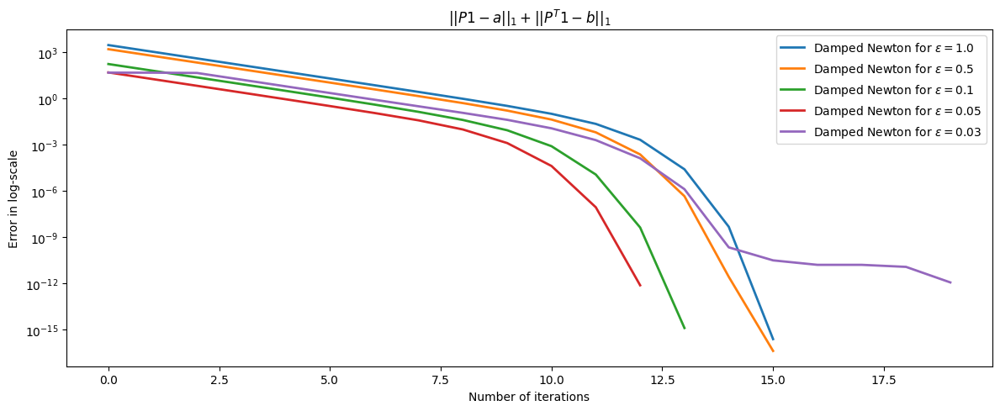


 Error plots can increase! The error is not the objective function!


In [57]:
plt.figure(figsize = (12,5))
plt.title("$$")
plt.title("$||P1 -a||_1+||P^T 1 -b||_1$")

for i in range(len(results_DampedNewton)):
  error=np.asarray(results_DampedNewton[i]['error_a'])+np.asarray(results_DampedNewton[i]['error_b'])
  plt.plot( error,label='Damped Newton for $\epsilon=$'+ str(epsilons[i]), linewidth = 2)

plt.xlabel("Number of iterations")
plt.ylabel("Error in log-scale")
plt.legend()
plt.yscale( 'log')
plt.tight_layout()
plt.savefig("DampedNewtonTesting_images/ErrorLinesearchNewton.png")
plt.show()

print("\n Error plots can increase! The error is not the objective function!")

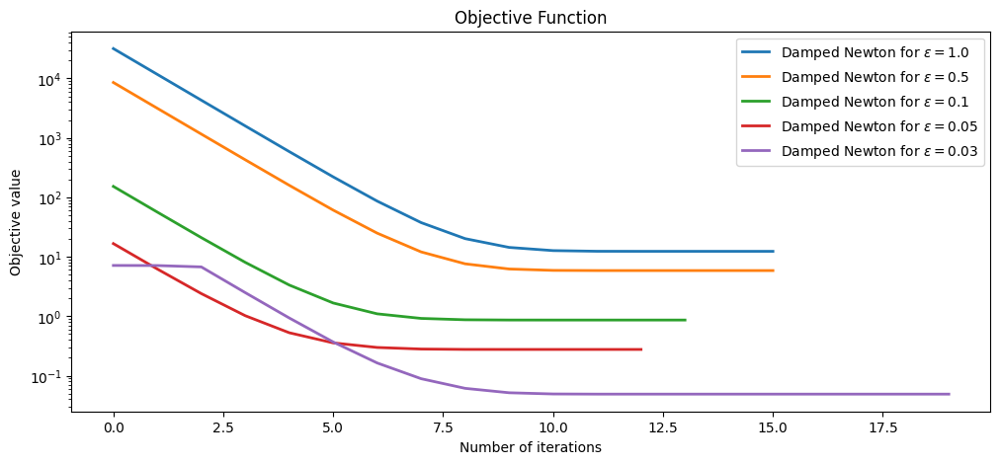

In [58]:
plt.figure(figsize = (12,5))
plt.title("$$")

plt.title("Objective Function")

for i in range(len(results_DampedNewton)):
  value = np.asarray(results_DampedNewton[i]['objectives'])
  value = -(value)
  plt.plot( value,label='Damped Newton for $\epsilon=$'+ str(epsilons[i]), linewidth = 2)

plt.xlabel("Number of iterations")
plt.ylabel("Objective value")
plt.yscale('log')
plt.legend()
plt.savefig("DampedNewtonTesting_images/ObjectiveLineSearchNewton.png")
plt.show()


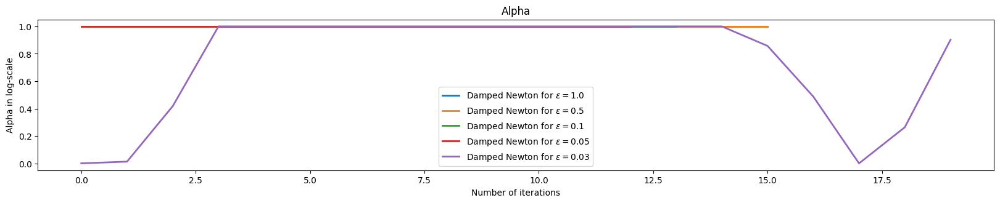

In [59]:
plt.figure(figsize = (20,7))
plt.subplot(2,1,1),
plt.title("Alpha")

for i in range(len(results_DampedNewton)):
  plt.plot( np.asarray(results_DampedNewton[i]["linesearch_steps"]),label='Damped Newton for $\epsilon=$'+ str(epsilons[i]), linewidth = 2)

plt.xlabel("Number of iterations")
plt.ylabel("Alpha in log-scale")
plt.legend()
# plt.yscale( 'log')
plt.savefig("DampedNewtonTesting_images/AlphaLineSearchNewton.png")
plt.show()



In [60]:
def print_spectral_statistics(mat, stabilize=False):
    if stabilize:
        # Stabilizing largest and smallest eigenvalue
        min_vector = np.hstack( (np.ones(N[0]), -np.ones(N[1])) )
        max_vector = np.hstack( (np.ones(N[0]),  np.ones(N[1])) )
        norm = np.sqrt( N[0] + N[1] )
        min_vector = min_vector/norm
        max_vector = max_vector/norm
        min_vector = min_vector.reshape( (min_vector.shape[0], 1) )
        max_vector = max_vector.reshape( (max_vector.shape[0], 1) )
        #
        mat = mat + np.dot( min_vector, min_vector.T)
        mat = mat - np.dot( max_vector, max_vector.T)
    # endif
    eig, v = np.linalg.eigh( mat )
    sorting_indices = np.argsort(eig)
    eig = eig[sorting_indices]
    v   = v[:, sorting_indices]
    
    #print( "Mean eigenvalue: ", np.mean(eig) )
    print( "List of smallest eigenvalues: ", eig[:10])
    print( "List of largest  eigenvalues: ", eig[-10:])
    min_index = np.argmin(eig)
    max_index = np.argmax(eig)
    min_value = eig[ min_index ]
    max_value = eig[max_index]
    min_vector = v[:, min_index]
    min_vector = min_vector/min_vector[0]
    max_vector = v[:,max_index]
    max_vector = max_vector/max_vector[0]
    condition_number = max_value/min_value
    # Test smallest and largest
    # print( "Min eigenvalue vector: ", min_vector)
    # print( "Max eigenvalue vector: ", max_vector)
    #
    #print( v[:,0]*np.sqrt( self.N1 + self.N2))
    #vector = v[:,0]
    #test = np.dot( result, vector)
    #print( np.linalg.norm(test) )
    #print("Min absolute eigenvalues: ", min_value)
    #print("Norm of v-1: ", np.linalg.norm(min_vector-eig_vector))
    print("Condition number: ", condition_number)
    # plt.hist( eig, 50)
    # plt.title( "Histogram of eigenvalues for Hessian")
    # plt.xlabel( "Eigenvalues")
    # plt.yscale( "log" )
    # plt.show()
    return eig,v

In [61]:
eigs=[]
eigvecs=[]
for i in range(len(epsilons)):
    eps = epsilons[i]
    print("Spectral statistics of Hessian for epsilon="+str(eps))
    Hessian = Hessians_DampedNewton[i]
    ev=print_spectral_statistics( Hessian, stabilize=False)
    eigs.append(ev[0])
    eigvecs.append(ev[1])
    print("")


Spectral statistics of Hessian for epsilon=1.0
List of smallest eigenvalues:  [0.10557281 0.68529891 0.70246594 0.92459419 0.9501032  0.99047064
 0.99106987 0.99125671 0.9987095  0.9987668 ]
List of largest  eigenvalues:  [1.00123329 1.00129059 1.00874338 1.00893019 1.00952942 1.04989687
 1.07540588 1.29753413 1.31470116 1.89442727]
Condition number:  17.944271909999124

Spectral statistics of Hessian for epsilon=0.5
List of smallest eigenvalues:  [0.10557281 0.48405216 0.50517805 0.78372218 0.84555571 0.94759987
 0.95047386 0.97267466 0.98888491 0.99046434]
List of largest  eigenvalues:  [1.00953566 1.01111509 1.02732534 1.04952614 1.05240013 1.15444429
 1.21627782 1.49482195 1.51594784 1.89442719]
Condition number:  17.944271909999124

Spectral statistics of Hessian for epsilon=0.1
List of smallest eigenvalues:  [0.10557281 0.1864651  0.19578003 0.3375551  0.39952931 0.54661971
 0.56983882 0.68803216 0.7415433  0.82077619]
List of largest  eigenvalues:  [1.17922385 1.25845672 1.31196

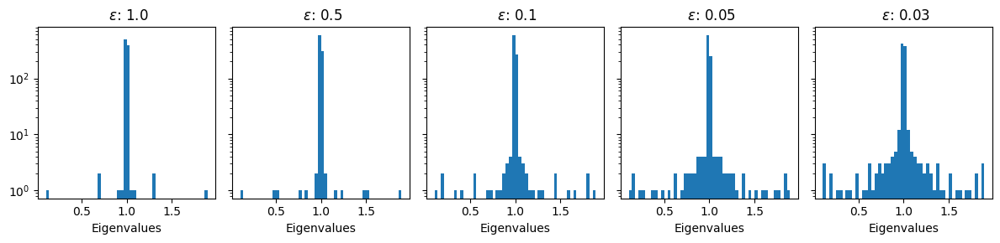

In [62]:
fig,ax=plt.subplots(figsize=(12,3),nrows=1, ncols=len(epsilons), sharey=True)
plt.title("Histogram of eigenvalues.")
for i in range(len(epsilons)):
    ax[i].hist( eigs[i], 50)
    ax[i].set_title( " $\epsilon$: "+str(epsilons[i]))
    ax[i].set_xlabel("Eigenvalues")
    ax[i].set_yscale( "log" )
plt.subplots_adjust(wspace=0,hspace=0)
plt.tight_layout()
plt.savefig("DampedNewtonTesting_images/eigenhistunstabilized.png")
plt.show()

## Heatmaps

### Heatmaps of eigenvectors corresponding to the 4 smallest eigenvalues

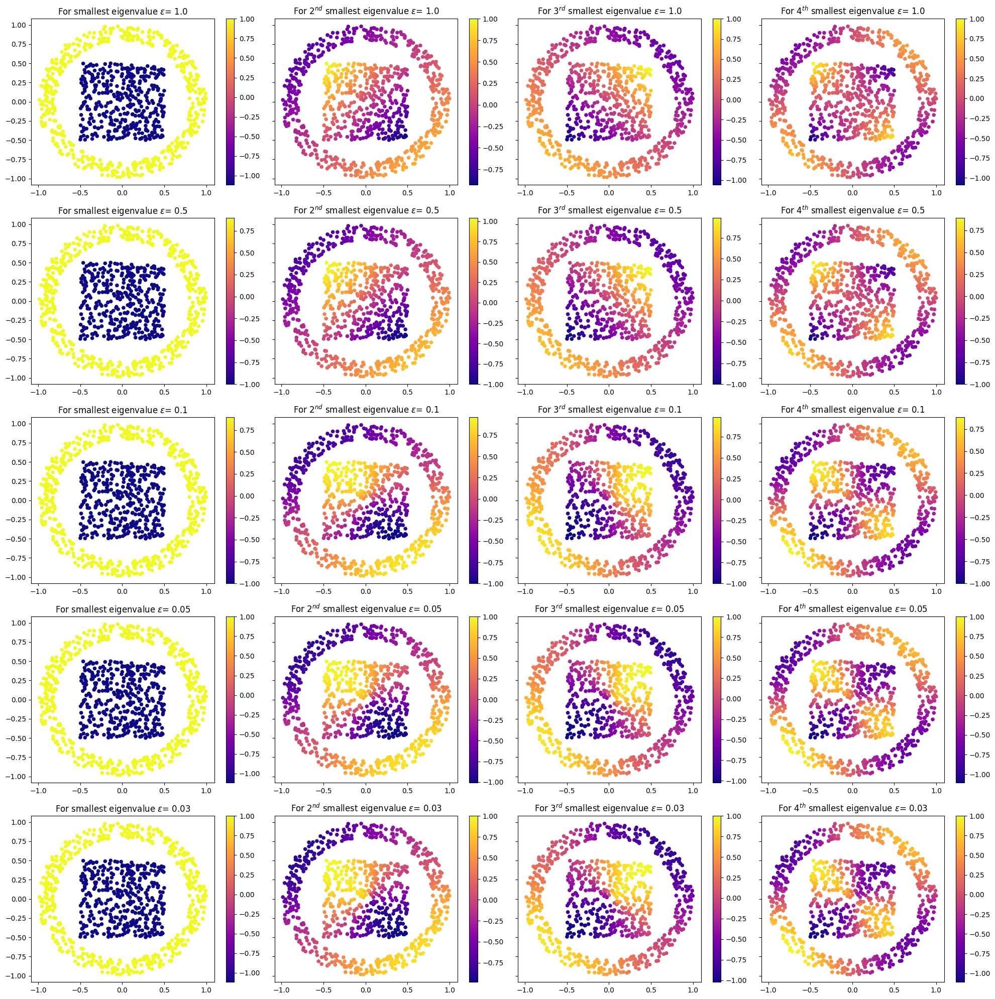

In [63]:
eigenmodes_count = 4

X=np.hstack((np.hstack((x[0,:],y[0,:]))[:,None],np.hstack((x[1,:],y[1,:]))[:,None]))
fig, ax = plt.subplots(figsize=(20,20),nrows=len(epsilons), ncols=eigenmodes_count,sharey=True)
scale = 30

courant_modes = []

for i in range(len(epsilons)):
    eigenvectors = eigvecs[i]
    courant_modes.append( [] )
    for j in range(eigenmodes_count):
        function_as_vector = eigenvectors[:,j]
        function_as_vector = function_as_vector/np.max(function_as_vector)
        # Flip sign if anti-correlated
        if i>0:
            old_mode = courant_modes[i-1][j]
            correlation = np.dot( old_mode, function_as_vector)/(np.linalg.norm(old_mode)*np.linalg.norm(function_as_vector))
            if correlation<-0.1:
                function_as_vector = -function_as_vector
            #print( "epsilon: ", i, " -- corr = ", correlation )
        # Record
        courant_modes[i].append( function_as_vector )
        # Plot
        im1 = ax[i][j].scatter(X.T[0,:], X.T[1,:], s=scale, edgecolors=(0,0,0,0),  c=function_as_vector, cmap='plasma', linewidths=2)
        fig.colorbar(im1,ax=ax[i][j])
    # end for
    ax[i][0].set_title("For smallest eigenvalue $\epsilon$= "+str(epsilons[i]))
    ax[i][1].set_title("For $2^{nd}$ smallest eigenvalue $\epsilon$= "+str(epsilons[i]))
    ax[i][2].set_title("For $3^{rd}$ smallest eigenvalue $\epsilon$= "+str(epsilons[i]))
    ax[i][3].set_title("For $4^{th}$ smallest eigenvalue $\epsilon$= "+str(epsilons[i]))
    #ax[i][4].set_title("For $5^{th}$ smallest eigenvalue $\epsilon$= "+str(epsilons[i]))
# end for

#fig.colorbar(im1, ax=ax.ravel().tolist())
plt.xlim(np.min(X.T[0,:])-.1,np.max(X.T[0,:])+.1)
plt.ylim(np.min(X.T[1,:])-.1,np.max(X.T[1,:])+.1)
plt.subplots_adjust(wspace=0,hspace=0.09)
plt.tight_layout()
plt.savefig("DampedNewtonTesting_images/Eigenheatmaplowest4L2.png")
plt.show();



### Heatmaps of eigenvectors corresponding to the 16 smallest eigenvalues

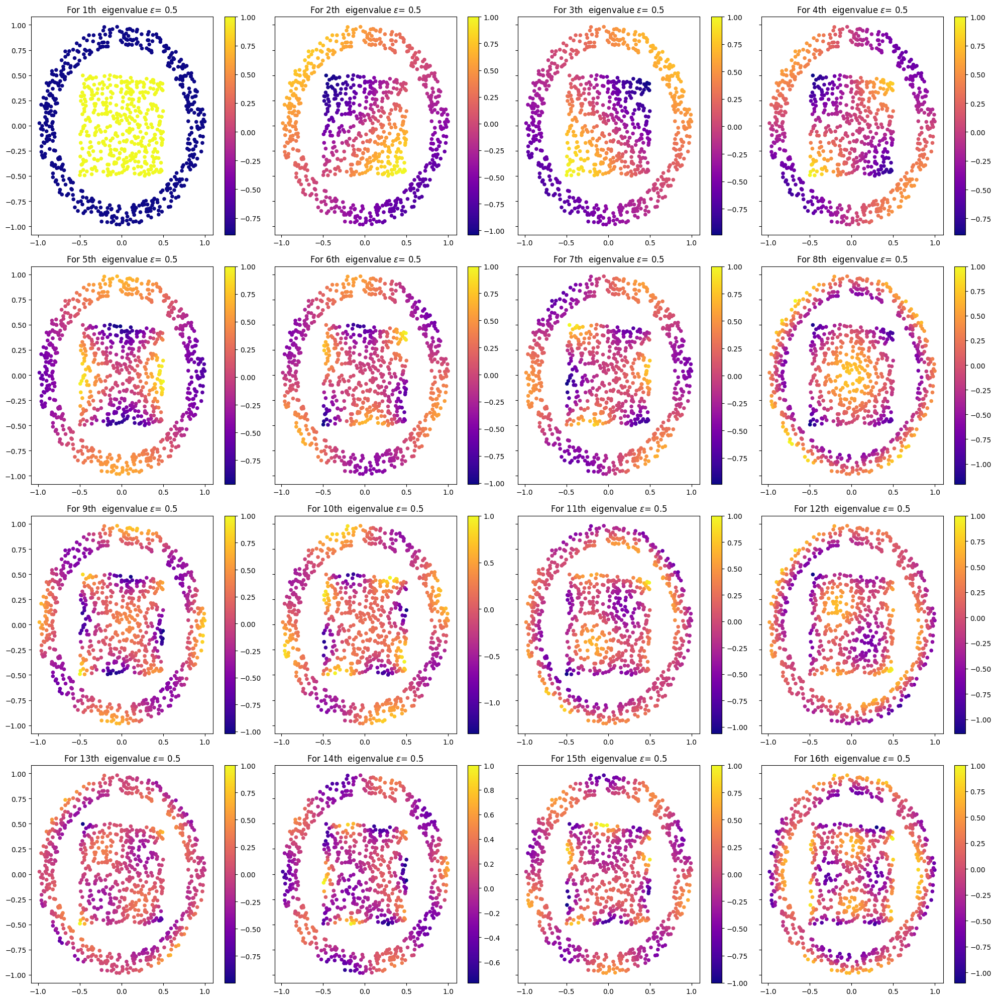

In [64]:
eigenmodes_count = 16

X=np.hstack((np.hstack((x[0,:],y[0,:]))[:,None],np.hstack((x[1,:],y[1,:]))[:,None]))
fig, ax = plt.subplots(figsize=(20,20),nrows=eigenmodes_count//4, ncols=eigenmodes_count//4,sharey=True)
scale = 30

courant_modes = []
k=0
for i in range(eigenmodes_count//4):
    eigenvectors = eigvecs[1]
    courant_modes.append( [] )
    for j in range(eigenmodes_count//4):
        function_as_vector = eigenvectors[:,j+4*k]
        function_as_vector = function_as_vector/np.max(function_as_vector)
        # Flip sign if anti-correlated
        if i>0:
            old_mode = courant_modes[i-1][j]
            correlation = np.dot( old_mode, function_as_vector)/(np.linalg.norm(old_mode)*np.linalg.norm(function_as_vector))
            if correlation<-0.1:
                function_as_vector = -function_as_vector
        # Record
        courant_modes[i].append( function_as_vector )
        # Plot
        im1 = ax[i][j].scatter(X.T[0,:], X.T[1,:], s=scale, edgecolors=(0,0,0,0),  c=function_as_vector, cmap='plasma', linewidths=2)
        fig.colorbar(im1,ax=ax[i][j])
    # end for
    ax[i][0].set_title("For "+str(1+4*k)+"th  eigenvalue $\epsilon$= "+str(epsilons[1]))
    ax[i][1].set_title("For "+str(2+4*k)+"th  eigenvalue $\epsilon$= "+str(epsilons[1]))
    ax[i][2].set_title("For "+str(3+4*k)+"th  eigenvalue $\epsilon$= "+str(epsilons[1]))
    ax[i][3].set_title("For "+str(4+4*k)+"th  eigenvalue $\epsilon$= "+str(epsilons[1]))
    #ax[i][4].set_title("For $5^{th}$ smallest eigenvalue $\epsilon$= "+str(epsilons[i]))
    k+=1
# end for

#fig.colorbar(im1, ax=ax.ravel().tolist())
plt.xlim(np.min(X.T[0,:])-.1,np.max(X.T[0,:])+.1)
plt.ylim(np.min(X.T[1,:])-.1,np.max(X.T[1,:])+.1)
plt.subplots_adjust(wspace=0,hspace=0.09)
plt.tight_layout()
plt.savefig("DampedNewtonTesting_images/EigenheatmaplowestL2.png")
plt.show();



### Heatmaps of eigenvectors corresponding to the 4 largest eigenvalues

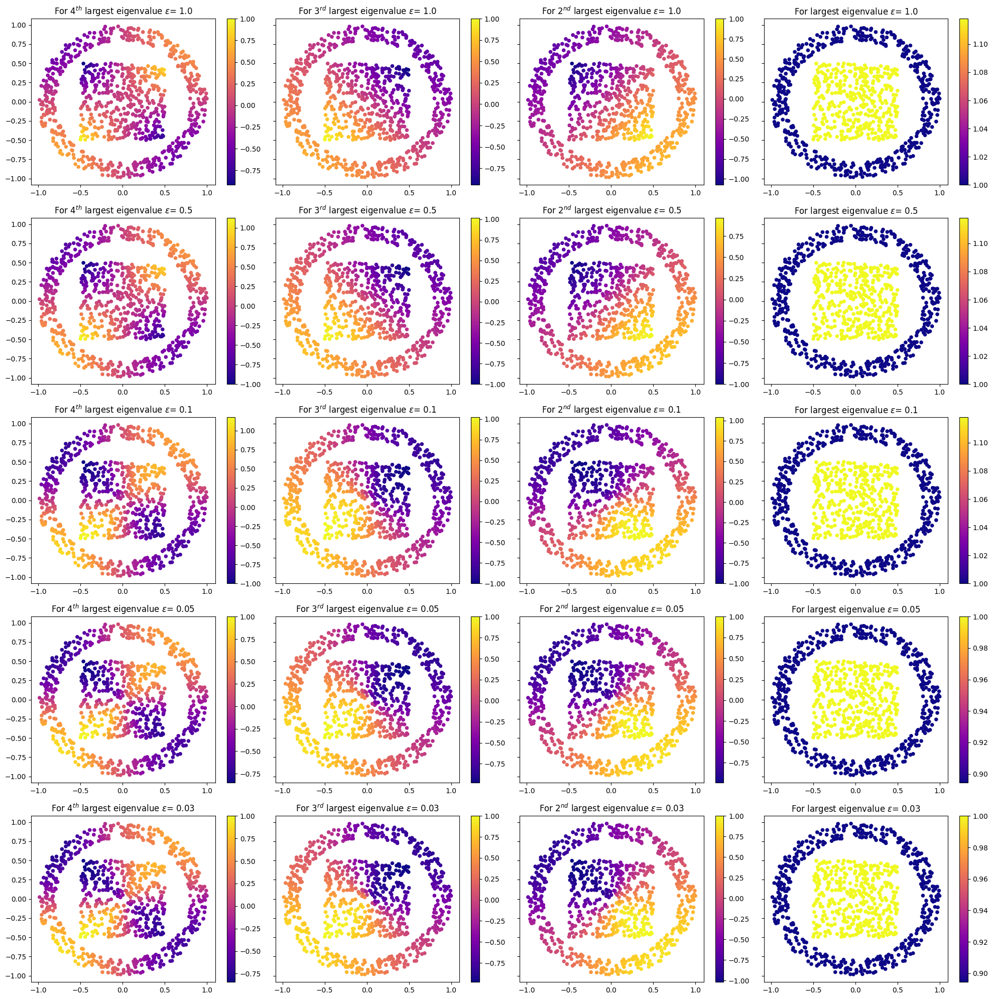

In [65]:
eigenmodes_count=4
X=np.hstack((np.hstack((x[0,:],y[0,:]))[:,None],np.hstack((x[1,:],y[1,:]))[:,None]))
fig, ax = plt.subplots(figsize=(20,20),nrows=len(epsilons), ncols=eigenmodes_count,sharey=True)
scale = 30
courant_modes = []

for i in range(len(epsilons)):
    eigenvectors = eigvecs[i]
    courant_modes.append( [] )
    for j in range(eigenmodes_count):
        function_as_vector = eigenvectors[:,N[0]+N[1]-j-1]
        function_as_vector = function_as_vector/np.max(function_as_vector)
        # Flip sign if anti-correlated
        if i>0:
            old_mode = courant_modes[i-1][j]
            correlation = np.dot( old_mode, function_as_vector)/(np.linalg.norm(old_mode)*np.linalg.norm(function_as_vector))
            if correlation<-0.1:
                function_as_vector = -function_as_vector
            #print( "epsilon: ", i, " -- corr = ", correlation )
        # Record
        courant_modes[i].append( function_as_vector )
        # Plot
        im = ax[i][eigenmodes_count-j-1].scatter(X.T[0,:], X.T[1,:], s=scale, edgecolors=(0,0,0,0),  c=function_as_vector, cmap='plasma', linewidths=2)
        fig.colorbar(im,ax=ax[i][eigenmodes_count-j-1])
    # end for
    ax[i][3].set_title("For largest eigenvalue $\epsilon$= "+str(epsilons[i]))
    ax[i][2].set_title("For $2^{nd}$ largest eigenvalue $\epsilon$= "+str(epsilons[i]))
    ax[i][1].set_title("For $3^{rd}$ largest eigenvalue $\epsilon$= "+str(epsilons[i]))
    ax[i][0].set_title("For $4^{th}$ largest eigenvalue $\epsilon$= "+str(epsilons[i]))
    #ax[i][0].set_title("For $5^{th}$ largest eigenvalue $\epsilon$= "+str(epsilons[i]))

# plt.axis("off")
plt.xlim(np.min(X.T[0,:])-.1,np.max(X.T[0,:])+.1)   
plt.ylim(np.min(X.T[1,:])-.1,np.max(X.T[1,:])+.1)
plt.subplots_adjust(wspace=0,hspace=0.09)
plt.tight_layout()
plt.savefig("DampedNewtonTesting_images/Eigenheatmaplargest4L2.png")
plt.show();



### Heatmaps of eigenvectors corresponding to the 16 largest eigenvalues

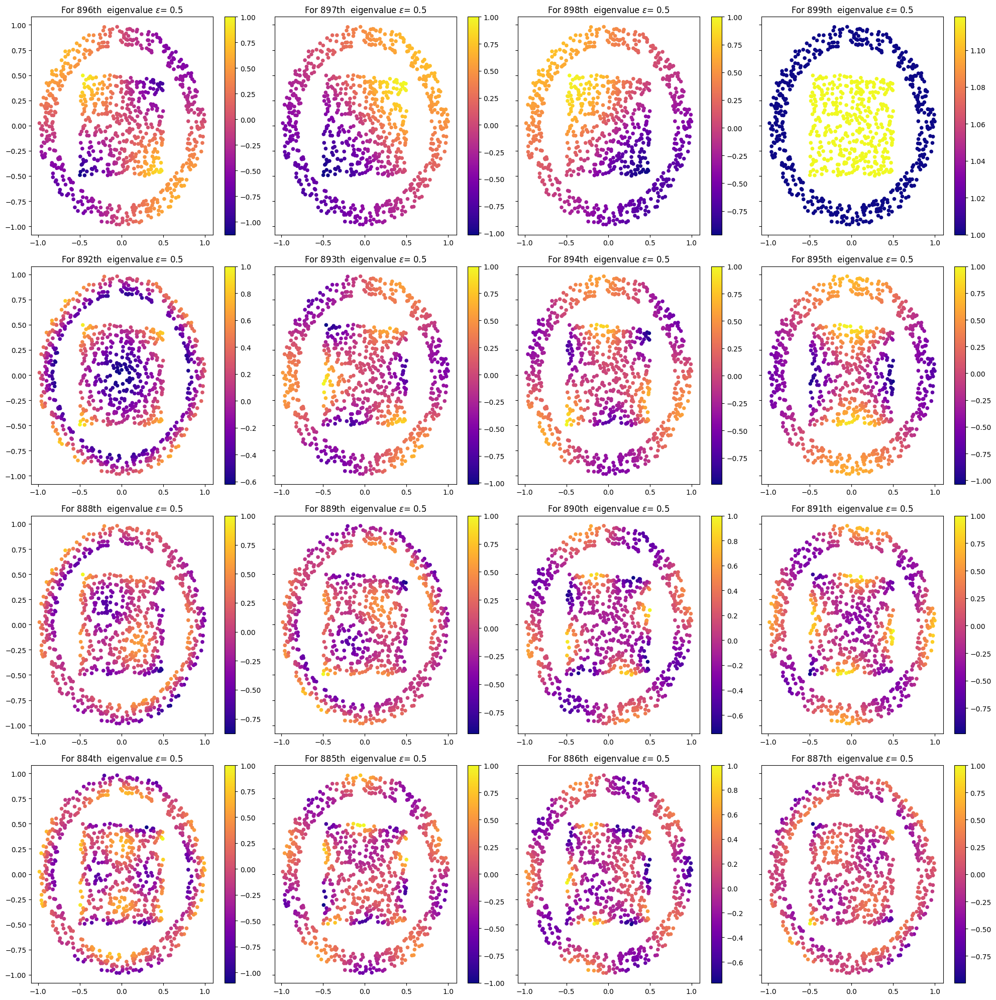

In [66]:
eigenmodes_count = 16

X=np.hstack((np.hstack((x[0,:],y[0,:]))[:,None],np.hstack((x[1,:],y[1,:]))[:,None]))
fig, ax = plt.subplots(figsize=(20,20),nrows=eigenmodes_count//4, ncols=eigenmodes_count//4,sharey=True)
scale = 30

courant_modes = []
k=0
for i in range(eigenmodes_count//4):
    eigenvectors = eigvecs[1]
    courant_modes.append( [] )
    for j in range(eigenmodes_count//4):
        function_as_vector = eigenvectors[:,N[0]+N[1]-j-1-4*k]
        function_as_vector = function_as_vector/np.max(function_as_vector)
        # Flip sign if anti-correlated
        if i>0:
            old_mode = courant_modes[i-1][j]
            correlation = np.dot( old_mode, function_as_vector)/(np.linalg.norm(old_mode)*np.linalg.norm(function_as_vector))
            if correlation<-0.1:
                function_as_vector = -function_as_vector
            #print( "epsilon: ", i, " -- corr = ",
            #  correlation )
        # Record
        courant_modes[i].append( function_as_vector )
        # Plot
        im = ax[i][eigenmodes_count//4-j-1].scatter(X.T[0,:], X.T[1,:], s=scale, edgecolors=(0,0,0,0),  c=function_as_vector, cmap='plasma', linewidths=2)
        fig.colorbar(im,ax=ax[i][eigenmodes_count//4-j-1])
    # end for
    ax[i][3].set_title("For "+str(N[0]+N[1]-1-4*k)+"th  eigenvalue $\epsilon$= "+str(epsilons[1]))
    ax[i][2].set_title("For "+str(N[0]+N[1]-2-4*k)+"th  eigenvalue $\epsilon$= "+str(epsilons[1]))
    ax[i][1].set_title("For "+str(N[0]+N[1]-3-4*k)+"th  eigenvalue $\epsilon$= "+str(epsilons[1]))
    ax[i][0].set_title("For "+str(N[0]+N[1]-4-4*k)+"th  eigenvalue $\epsilon$= "+str(epsilons[1]))
    #ax[i][0].set_title("For $5^{th}$ largest eigenvalue $\epsilon$= "+str(epsilons[i]))
    k+=1
# plt.axis("off")
plt.xlim(np.min(X.T[0,:])-.1,np.max(X.T[0,:])+.1)   
plt.ylim(np.min(X.T[1,:])-.1,np.max(X.T[1,:])+.1)
plt.subplots_adjust(wspace=0,hspace=0.09)
plt.tight_layout()
plt.savefig("DampedNewtonTesting_images/EigenheatmaplargestL2.png")
plt.show();



# L1-norm

In [67]:
rho = 0.95
c = 0.05
DampedNewtonP = []
results_DampedNewton  = []
times_DampedNewton    = []
Hessians_DampedNewton = []

#epsilons=[0.05,0.08,0.1]
#epsilons=[0.1, 0.2, 0.3, 0.4, 0.5, 0.75, 1.0 ]
epsilons = [ 1.0, 0.5, 0.1, 0.05,0.03 ]
for eps in epsilons:
    # Line Search
    print("Damped Newton for epsilon="+str(eps)+":")    
    #Cost matrix
    C = p_norms(x,y,1)

    # a and b
    a = normalize(np.ones(N[0]))
    a = a.reshape(a.shape[0],-1)
    b = normalize(np.ones(N[1]))
    b = b.reshape(b.shape[0],-1)

    #Epsilon 

    # epsilon = .05

    #Kernel
    K = np.exp(-C/eps)

    f,g = 0*a,0*b

    print("Doing for (",N[0],N[1],").")
    print( " |- Iterating")  
    start = time.time()
    Optimizer = computational_OT.DampedNewton(K,a,b,f,g,eps,rho,c)
    out=Optimizer._update(maxiter=50, debug=True)
    results_DampedNewton.append(out)
    end=time.time()
    times_DampedNewton.append(end-start)
    print( " |- Computing P")
    
    DampedNewtonP.append(GetP(np.exp(out['potential_f']/eps),K,np.exp(out['potential_g']/eps)))
    print( " |- Recording (unstabilized) Hessian \n")

    mat  = -eps*Optimizer.Hessian
    diag = 1/np.sqrt( np.vstack( (a,b) ) ).flatten()
    mat = diag*mat*diag
    Hessians_DampedNewton.append( mat )


Damped Newton for epsilon=1.0:
Doing for ( 400 500 ).
 |- Iterating
Terminating after iteration:  16
 |- Computing P
 |- Recording (unstabilized) Hessian 

Damped Newton for epsilon=0.5:
Doing for ( 400 500 ).
 |- Iterating
Terminating after iteration:  16
 |- Computing P
 |- Recording (unstabilized) Hessian 

Damped Newton for epsilon=0.1:
Doing for ( 400 500 ).
 |- Iterating
Terminating after iteration:  15
 |- Computing P
 |- Recording (unstabilized) Hessian 

Damped Newton for epsilon=0.05:
Doing for ( 400 500 ).
 |- Iterating
Terminating after iteration:  15
 |- Computing P
 |- Recording (unstabilized) Hessian 

Damped Newton for epsilon=0.03:
Doing for ( 400 500 ).
 |- Iterating
Terminating after iteration:  17
 |- Computing P
 |- Recording (unstabilized) Hessian 



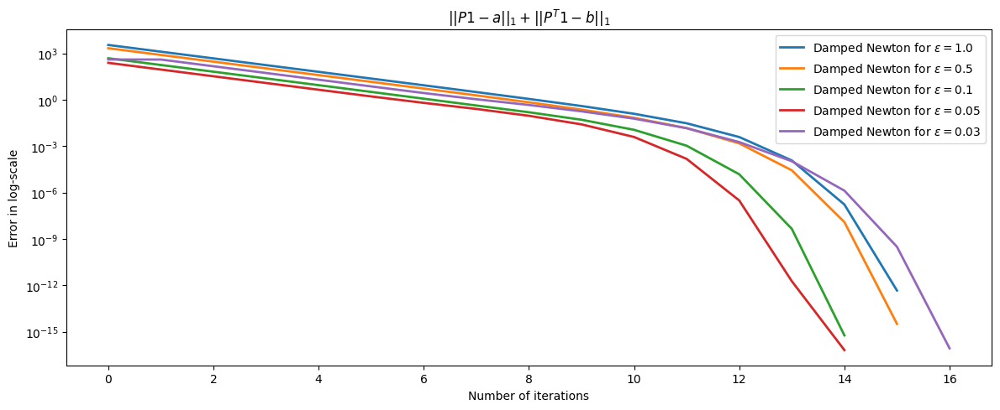


 Error plots can increase! The error is not the objective function!


In [68]:
plt.figure(figsize = (12,5))
plt.title("$$")
plt.title("$||P1 -a||_1+||P^T 1 -b||_1$")

for i in range(len(results_DampedNewton)):
  error=np.asarray(results_DampedNewton[i]['error_a'])+np.asarray(results_DampedNewton[i]['error_b'])
  plt.plot( error,label='Damped Newton for $\epsilon=$'+ str(epsilons[i]), linewidth = 2)

plt.xlabel("Number of iterations")
plt.ylabel("Error in log-scale")
plt.legend()
plt.yscale( 'log')
plt.tight_layout()
plt.savefig("DampedNewtonTesting_images/ErrorLinesearchNewtonL1.png")
plt.show()

print("\n Error plots can increase! The error is not the objective function!")

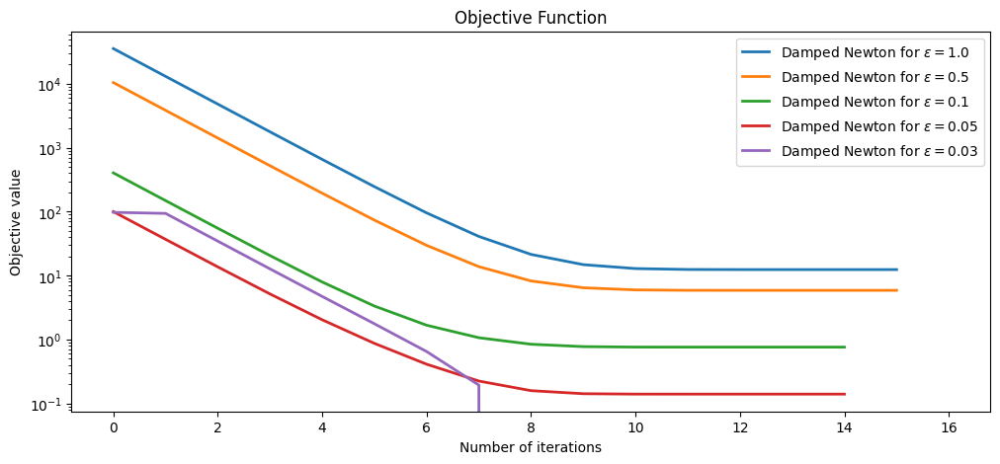

In [69]:
plt.figure(figsize = (12,5))
plt.title("$$")

plt.title("Objective Function")

for i in range(len(results_DampedNewton)):
  value = np.asarray(results_DampedNewton[i]['objectives'])
  value = -(value)
  plt.plot( value,label='Damped Newton for $\epsilon=$'+ str(epsilons[i]), linewidth = 2)

plt.xlabel("Number of iterations")
plt.ylabel("Objective value")
plt.yscale('log')
plt.legend()
plt.savefig("DampedNewtonTesting_images/ObjectiveLineSearchNewtonL1.png")
plt.show()


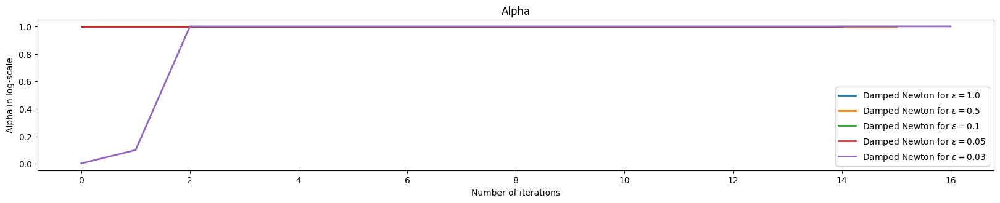

In [70]:
plt.figure(figsize = (20,7))
plt.subplot(2,1,1),
plt.title("Alpha")

for i in range(len(results_DampedNewton)):
  plt.plot( np.asarray(results_DampedNewton[i]["linesearch_steps"]),label='Damped Newton for $\epsilon=$'+ str(epsilons[i]), linewidth = 2)

plt.xlabel("Number of iterations")
plt.ylabel("Alpha in log-scale")
plt.legend()
# plt.yscale( 'log')
plt.savefig("DampedNewtonTesting_images/AlphaLineSearchNewtonL1.png")
plt.show()



In [71]:
eigs=[]
eigvecs=[]
for i in range(len(epsilons)):
    eps = epsilons[i]
    print("Spectral statistics of Hessian for epsilon="+str(eps))
    Hessian = Hessians_DampedNewton[i]
    ev=print_spectral_statistics( Hessian, stabilize=False)
    eigs.append(ev[0])
    eigvecs.append(ev[1])
    print("")


Spectral statistics of Hessian for epsilon=1.0
List of smallest eigenvalues:  [0.10557294 0.6960483  0.90858782 0.95625474 0.97298284 0.98332126
 0.98847962 0.99171383 0.99373036 0.99515852]
List of largest  eigenvalues:  [1.00484528 1.00627339 1.00829001 1.01152424 1.01668241 1.02702077
 1.04374872 1.09141699 1.30395304 1.89442945]
Condition number:  17.94427191008709

Spectral statistics of Hessian for epsilon=0.5
List of smallest eigenvalues:  [0.10557282 0.49212476 0.81164869 0.90025191 0.93502538 0.95827243
 0.97048135 0.97838504 0.98352354 0.9872049 ]
List of largest  eigenvalues:  [1.01279532 1.0164767  1.02161519 1.02951889 1.04172779 1.06497484
 1.09974827 1.18835165 1.5078753  1.89442733]
Condition number:  17.94427190999967

Spectral statistics of Hessian for epsilon=0.1
List of smallest eigenvalues:  [0.10557281 0.18848387 0.55847492 0.69967989 0.77309065 0.82197565
 0.85969072 0.88730916 0.90386293 0.91850224]
List of largest  eigenvalues:  [1.08149785 1.09613713 1.1126909

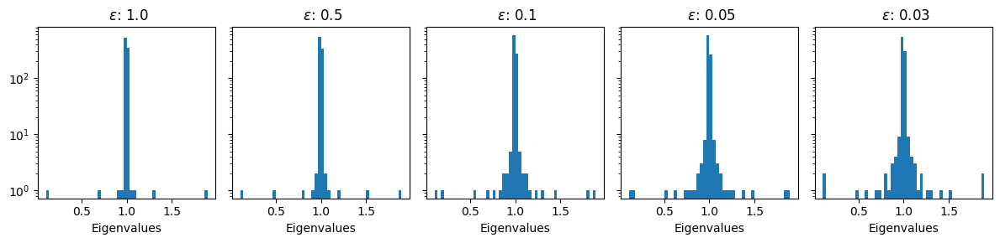

In [72]:
fig,ax=plt.subplots(figsize=(12,3),nrows=1, ncols=len(epsilons), sharey=True)
plt.title("Histogram of eigenvalues.")
for i in range(len(epsilons)):
    ax[i].hist( eigs[i], 50)
    ax[i].set_title( " $\epsilon$: "+str(epsilons[i]))
    ax[i].set_xlabel("Eigenvalues")
    ax[i].set_yscale( "log" )
plt.subplots_adjust(wspace=0,hspace=0)
plt.tight_layout()
plt.savefig("DampedNewtonTesting_images/eigenhistunstabilizedL1.png")
plt.show()

### Heatmaps of eigenvectors corresponding to the 16 smallest eigenvalues 

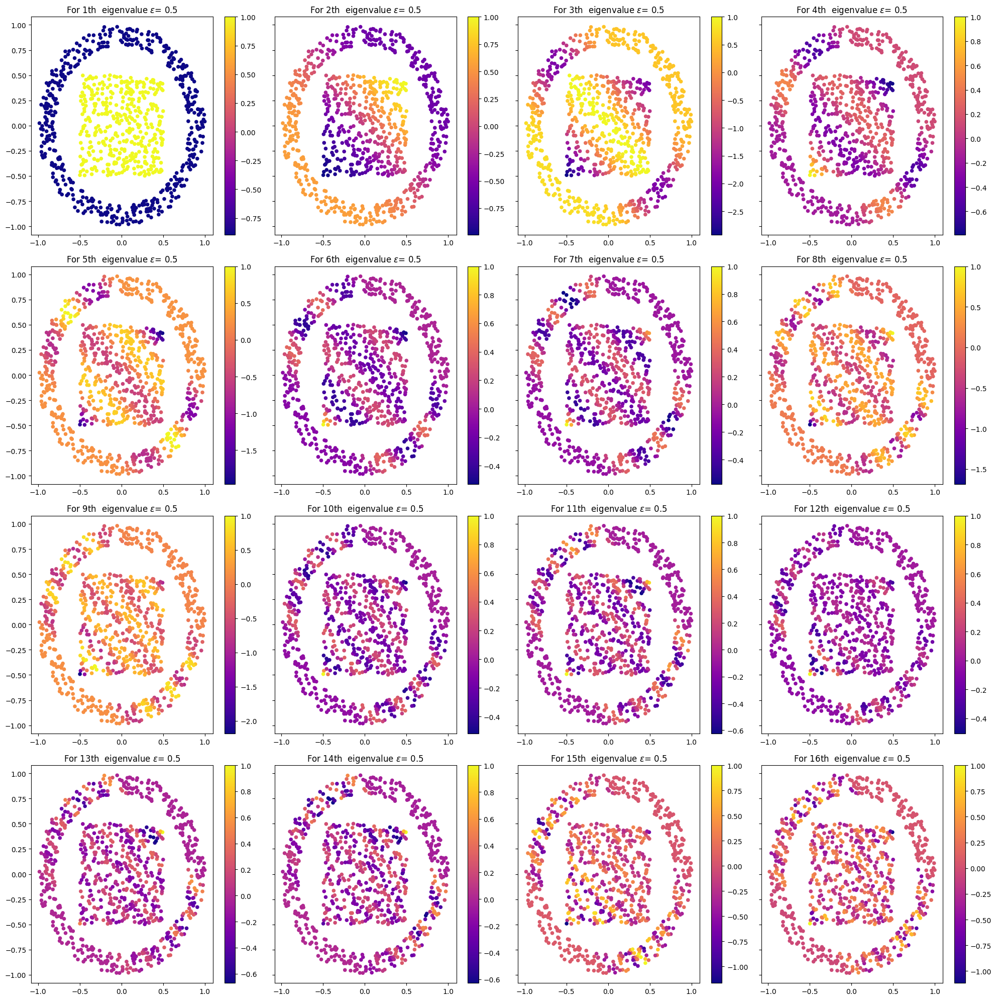

In [73]:
eigenmodes_count = 16

X=np.hstack((np.hstack((x[0,:],y[0,:]))[:,None],np.hstack((x[1,:],y[1,:]))[:,None]))
fig, ax = plt.subplots(figsize=(20,20),nrows=eigenmodes_count//4, ncols=eigenmodes_count//4,sharey=True)
scale = 30

courant_modes = []
k=0
for i in range(eigenmodes_count//4):
    eigenvectors = eigvecs[1]
    courant_modes.append( [] )
    for j in range(eigenmodes_count//4):
        function_as_vector = eigenvectors[:,j+4*k]
        function_as_vector = function_as_vector/np.max(function_as_vector)
        # Flip sign if anti-correlated
        if i>0:
            old_mode = courant_modes[i-1][j]
            correlation = np.dot( old_mode, function_as_vector)/(np.linalg.norm(old_mode)*np.linalg.norm(function_as_vector))
            if correlation<-0.1:
                function_as_vector = -function_as_vector
        # Record
        courant_modes[i].append( function_as_vector )
        # Plot
        im1 = ax[i][j].scatter(X.T[0,:], X.T[1,:], s=scale, edgecolors=(0,0,0,0),  c=function_as_vector, cmap='plasma', linewidths=2)
        fig.colorbar(im1,ax=ax[i][j])
    # end for
    ax[i][0].set_title("For "+str(1+4*k)+"th  eigenvalue $\epsilon$= "+str(epsilons[1]))
    ax[i][1].set_title("For "+str(2+4*k)+"th  eigenvalue $\epsilon$= "+str(epsilons[1]))
    ax[i][2].set_title("For "+str(3+4*k)+"th  eigenvalue $\epsilon$= "+str(epsilons[1]))
    ax[i][3].set_title("For "+str(4+4*k)+"th  eigenvalue $\epsilon$= "+str(epsilons[1]))
    #ax[i][4].set_title("For $5^{th}$ smallest eigenvalue $\epsilon$= "+str(epsilons[i]))
    k+=1
# end for

#fig.colorbar(im1, ax=ax.ravel().tolist())
plt.xlim(np.min(X.T[0,:])-.1,np.max(X.T[0,:])+.1)
plt.ylim(np.min(X.T[1,:])-.1,np.max(X.T[1,:])+.1)
plt.subplots_adjust(wspace=0,hspace=0.09)
plt.tight_layout()
plt.savefig("DampedNewtonTesting_images/EigenheatmaplowestL1.png")
plt.show();



### Heatmaps of eigenvectors corresponding to the 16 largest eigenvalues

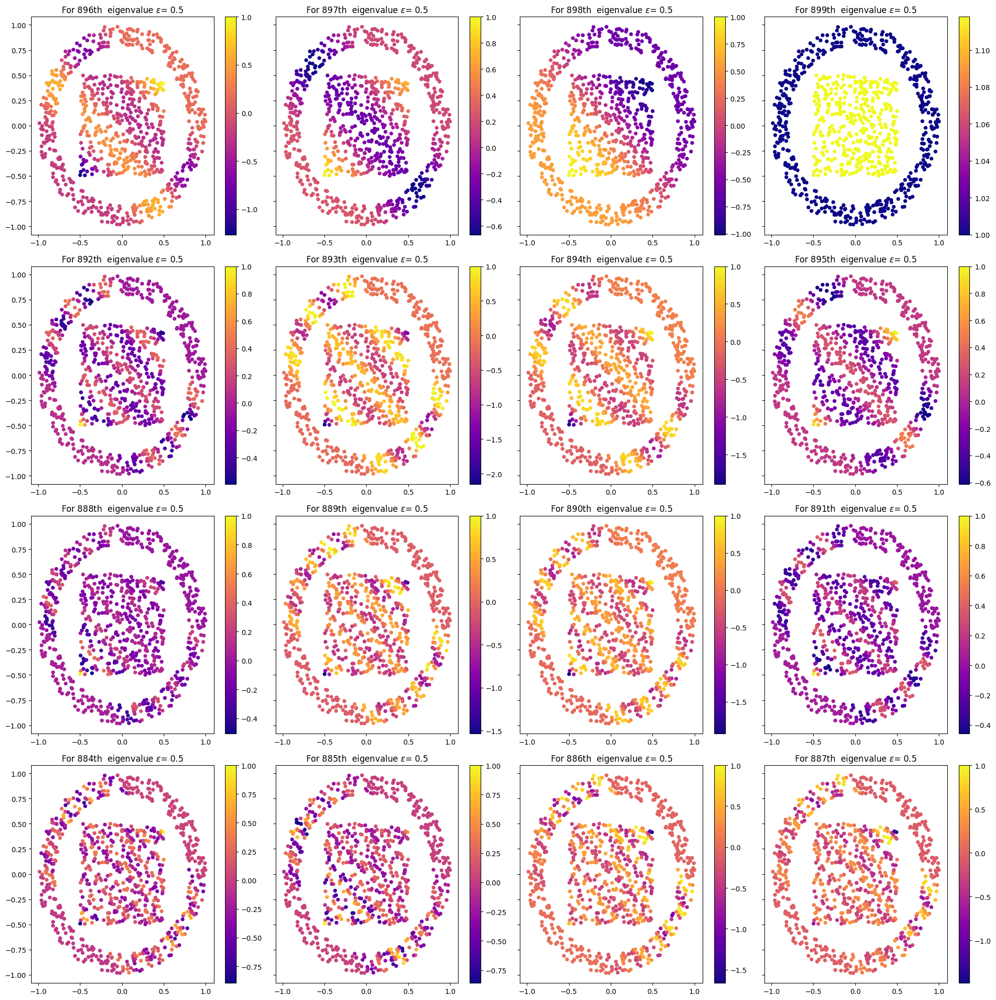

In [74]:
eigenmodes_count = 16

X=np.hstack((np.hstack((x[0,:],y[0,:]))[:,None],np.hstack((x[1,:],y[1,:]))[:,None]))
fig, ax = plt.subplots(figsize=(20,20),nrows=eigenmodes_count//4, ncols=eigenmodes_count//4,sharey=True)
scale = 30

courant_modes = []
k=0
for i in range(eigenmodes_count//4):
    eigenvectors = eigvecs[1]
    courant_modes.append( [] )
    for j in range(eigenmodes_count//4):
        function_as_vector = eigenvectors[:,N[0]+N[1]-j-1-4*k]
        function_as_vector = function_as_vector/np.max(function_as_vector)
        # Flip sign if anti-correlated
        if i>0:
            old_mode = courant_modes[i-1][j]
            correlation = np.dot( old_mode, function_as_vector)/(np.linalg.norm(old_mode)*np.linalg.norm(function_as_vector))
            if correlation<-0.1:
                function_as_vector = -function_as_vector
            #print( "epsilon: ", i, " -- corr = ",
            #  correlation )
        # Record
        courant_modes[i].append( function_as_vector )
        # Plot
        im = ax[i][eigenmodes_count//4-j-1].scatter(X.T[0,:], X.T[1,:], s=scale, edgecolors=(0,0,0,0),  c=function_as_vector, cmap='plasma', linewidths=2)
        fig.colorbar(im,ax=ax[i][eigenmodes_count//4-j-1])
    # end for
    ax[i][3].set_title("For "+str(N[0]+N[1]-1-4*k)+"th  eigenvalue $\epsilon$= "+str(epsilons[1]))
    ax[i][2].set_title("For "+str(N[0]+N[1]-2-4*k)+"th  eigenvalue $\epsilon$= "+str(epsilons[1]))
    ax[i][1].set_title("For "+str(N[0]+N[1]-3-4*k)+"th  eigenvalue $\epsilon$= "+str(epsilons[1]))
    ax[i][0].set_title("For "+str(N[0]+N[1]-4-4*k)+"th  eigenvalue $\epsilon$= "+str(epsilons[1]))
    #ax[i][0].set_title("For $5^{th}$ largest eigenvalue $\epsilon$= "+str(epsilons[i]))
    k+=1
# plt.axis("off")
plt.xlim(np.min(X.T[0,:])-.1,np.max(X.T[0,:])+.1)   
plt.ylim(np.min(X.T[1,:])-.1,np.max(X.T[1,:])+.1)
plt.subplots_adjust(wspace=0,hspace=0.09)
plt.tight_layout()
plt.savefig("DampedNewtonTesting_images/EigenheatmaplargestL1.png")
plt.show();



# L4-norm

In [75]:
rho = 0.95
c = 0.05
DampedNewtonP = []
results_DampedNewton  = []
times_DampedNewton    = []
Hessians_DampedNewton = []

#epsilons=[0.05,0.08,0.1]
#epsilons=[0.1, 0.2, 0.3, 0.4, 0.5, 0.75, 1.0 ]
epsilons = [ 1.0, 0.5, 0.1, 0.05,0.03 ]
for eps in epsilons:
    # Line Search
    print("Damped Newton for epsilon="+str(eps)+":")    
    #Cost matrix
    C = p_norms(x,y,4)

    # a and b
    a = normalize(np.ones(N[0]))
    a = a.reshape(a.shape[0],-1)
    b = normalize(np.ones(N[1]))
    b = b.reshape(b.shape[0],-1)

    #Epsilon 

    # epsilon = .05

    #Kernel
    K = np.exp(-C/eps)

    f,g = 0*a,0*b

    print("Doing for (",N[0],N[1],").")
    print( " |- Iterating")  
    start = time.time()
    Optimizer = computational_OT.DampedNewton(K,a,b,f,g,eps,rho,c)
    out=Optimizer._update(maxiter=50, debug=True)
    results_DampedNewton.append(out)
    end=time.time()
    times_DampedNewton.append(end-start)
    print( " |- Computing P")
    
    DampedNewtonP.append(GetP(np.exp(out['potential_f']/eps),K,np.exp(out['potential_g']/eps)))
    print( " |- Recording (unstabilized) Hessian \n")

    mat  = -eps*Optimizer.Hessian
    diag = 1/np.sqrt( np.vstack( (a,b) ) ).flatten()
    mat = diag*mat*diag
    Hessians_DampedNewton.append( mat )


Damped Newton for epsilon=1.0:
Doing for ( 400 500 ).
 |- Iterating
Terminating after iteration:  16
 |- Computing P
 |- Recording (unstabilized) Hessian 

Damped Newton for epsilon=0.5:
Doing for ( 400 500 ).
 |- Iterating
Terminating after iteration:  16
 |- Computing P
 |- Recording (unstabilized) Hessian 

Damped Newton for epsilon=0.1:
Doing for ( 400 500 ).
 |- Iterating
Terminating after iteration:  14
 |- Computing P
 |- Recording (unstabilized) Hessian 

Damped Newton for epsilon=0.05:
Doing for ( 400 500 ).
 |- Iterating
Terminating after iteration:  16
 |- Computing P
 |- Recording (unstabilized) Hessian 

Damped Newton for epsilon=0.03:
Doing for ( 400 500 ).
 |- Iterating
Terminating after iteration:  2
 |- Computing P
 |- Recording (unstabilized) Hessian 



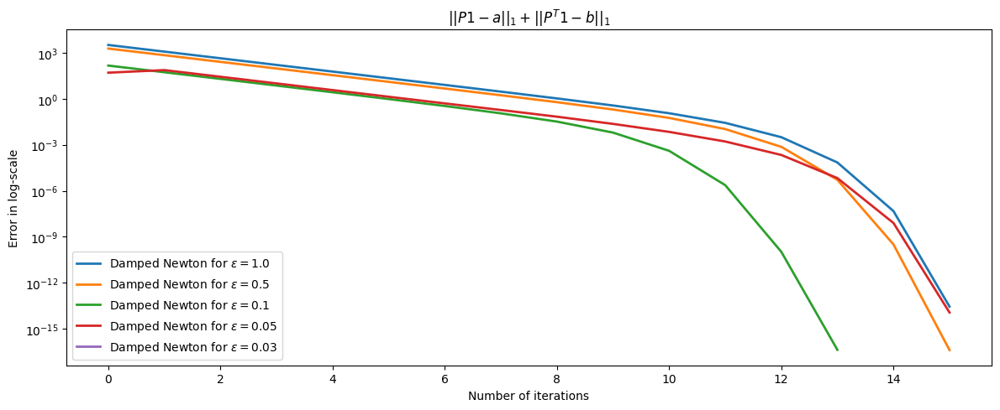


 Error plots can increase! The error is not the objective function!


In [76]:
plt.figure(figsize = (12,5))
plt.title("$$")
plt.title("$||P1 -a||_1+||P^T 1 -b||_1$")

for i in range(len(results_DampedNewton)):
  error=np.asarray(results_DampedNewton[i]['error_a'])+np.asarray(results_DampedNewton[i]['error_b'])
  plt.plot( error,label='Damped Newton for $\epsilon=$'+ str(epsilons[i]), linewidth = 2)

plt.xlabel("Number of iterations")
plt.ylabel("Error in log-scale")
plt.legend()
plt.yscale( 'log')
plt.tight_layout()
plt.savefig("DampedNewtonTesting_images/ErrorLinesearchNewtonL4.png")
plt.show()

print("\n Error plots can increase! The error is not the objective function!")

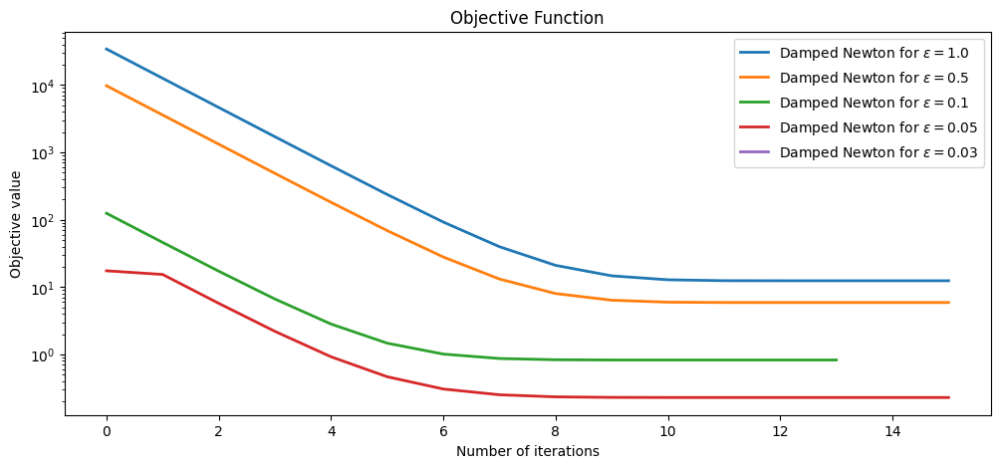

In [77]:
plt.figure(figsize = (12,5))
plt.title("$$")

plt.title("Objective Function")

for i in range(len(results_DampedNewton)):
  value = np.asarray(results_DampedNewton[i]['objectives'])
  value = -(value)
  plt.plot( value,label='Damped Newton for $\epsilon=$'+ str(epsilons[i]), linewidth = 2)

plt.xlabel("Number of iterations")
plt.ylabel("Objective value")
plt.yscale('log')
plt.legend()
plt.savefig("DampedNewtonTesting_images/ObjectiveLineSearchNewtonL4.png")
plt.show()


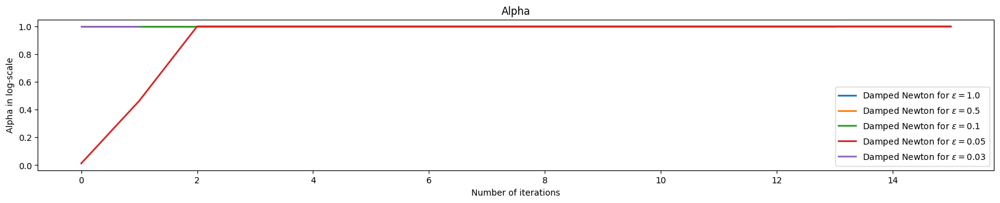

In [78]:
plt.figure(figsize = (20,7))
plt.subplot(2,1,1),
plt.title("Alpha")

for i in range(len(results_DampedNewton)):
  plt.plot( np.asarray(results_DampedNewton[i]["linesearch_steps"]),label='Damped Newton for $\epsilon=$'+ str(epsilons[i]), linewidth = 2)

plt.xlabel("Number of iterations")
plt.ylabel("Alpha in log-scale")
plt.legend()
# plt.yscale( 'log')
plt.savefig("DampedNewtonTesting_images/AlphaLineSearchNewtonL4.png")
plt.show()



In [79]:
eigs=[]
eigvecs=[]
for i in range(len(epsilons)):
    eps = epsilons[i]
    print("Spectral statistics of Hessian for epsilon="+str(eps))
    Hessian = Hessians_DampedNewton[i]
    ev=print_spectral_statistics( Hessian, stabilize=False)
    eigs.append(ev[0])
    eigvecs.append(ev[1])
    print("")


Spectral statistics of Hessian for epsilon=1.0
List of smallest eigenvalues:  [0.10557285 0.71036068 0.72840069 0.89509737 0.9655173  0.98202794
 0.98388307 0.9851661  0.98542595 0.98693901]
List of largest  eigenvalues:  [1.01306143 1.01457469 1.01483436 1.01611753 1.01797249 1.03448352
 1.10490304 1.27159979 1.28963978 1.89442788]
Condition number:  17.94427191000389

Spectral statistics of Hessian for epsilon=0.5
List of smallest eigenvalues:  [0.10557281 0.55351719 0.57996034 0.84300247 0.9069872  0.94287997
 0.95149856 0.95389061 0.96770649 0.96812453]
List of largest  eigenvalues:  [1.03187547 1.03229352 1.04610939 1.04850144 1.05712003 1.09301281
 1.15699753 1.42003967 1.44648282 1.8944272 ]
Condition number:  17.944271909999173

Spectral statistics of Hessian for epsilon=0.1
List of smallest eigenvalues:  [0.10557281 0.26947944 0.28664418 0.47739564 0.58415258 0.63240919
 0.6436236  0.67136771 0.74012483 0.74823909]
List of largest  eigenvalues:  [1.25176091 1.25987517 1.328632

The eigenvalues for 0.03 contains Nans.


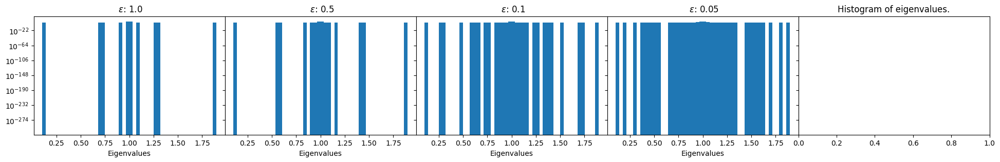

In [80]:
fig,ax = plt.subplots( figsize=(24,3),nrows=1, ncols=len(epsilons), sharey=True )
plt.title( "Histogram of eigenvalues." )
for i in range( len(epsilons) ):
    if not np.isnan(eigs[i]).any():
        ax[i].hist( eigs[i], 50 )
        ax[i].set_title( " $\epsilon$: "+str(epsilons[i]) )
        ax[i].set_xlabel( "Eigenvalues" )
        ax[i].set_yscale( "log" )
    
    else:
        print("The eigenvalues for "+str(epsilons[i])+ " contains Nans.")
plt.subplots_adjust( wspace=0,hspace=0 )
plt.savefig("DampedNewtonVsSinkhorn_benchmark_annulusVSsquare_images/eigenhistunstabilizedL4.png")
plt.show()

### Heatmaps of eigenvectors corresponding to the 16 smallest eigenvalues 

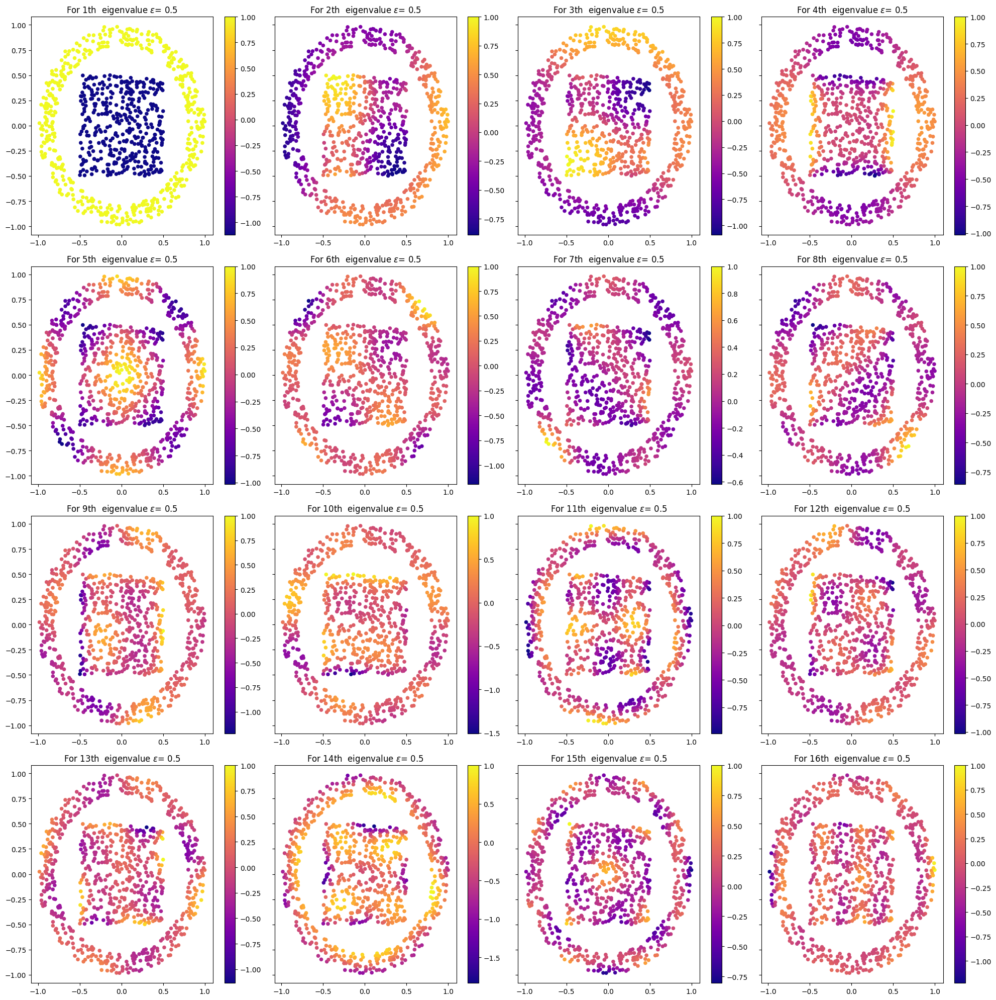

In [81]:
eigenmodes_count = 16

X=np.hstack((np.hstack((x[0,:],y[0,:]))[:,None],np.hstack((x[1,:],y[1,:]))[:,None]))
fig, ax = plt.subplots(figsize=(20,20),nrows=eigenmodes_count//4, ncols=eigenmodes_count//4,sharey=True)
scale = 30

courant_modes = []
k=0
for i in range(eigenmodes_count//4):
    eigenvectors = eigvecs[1]
    courant_modes.append( [] )
    for j in range(eigenmodes_count//4):
        function_as_vector = eigenvectors[:,j+4*k]
        function_as_vector = function_as_vector/np.max(function_as_vector)
        # Flip sign if anti-correlated
        if i>0:
            old_mode = courant_modes[i-1][j]
            correlation = np.dot( old_mode, function_as_vector)/(np.linalg.norm(old_mode)*np.linalg.norm(function_as_vector))
            if correlation<-0.1:
                function_as_vector = -function_as_vector
        # Record
        courant_modes[i].append( function_as_vector )
        # Plot
        im1 = ax[i][j].scatter(X.T[0,:], X.T[1,:], s=scale, edgecolors=(0,0,0,0),  c=function_as_vector, cmap='plasma', linewidths=2)
        fig.colorbar(im1,ax=ax[i][j])
    # end for
    ax[i][0].set_title("For "+str(1+4*k)+"th  eigenvalue $\epsilon$= "+str(epsilons[1]))
    ax[i][1].set_title("For "+str(2+4*k)+"th  eigenvalue $\epsilon$= "+str(epsilons[1]))
    ax[i][2].set_title("For "+str(3+4*k)+"th  eigenvalue $\epsilon$= "+str(epsilons[1]))
    ax[i][3].set_title("For "+str(4+4*k)+"th  eigenvalue $\epsilon$= "+str(epsilons[1]))
    #ax[i][4].set_title("For $5^{th}$ smallest eigenvalue $\epsilon$= "+str(epsilons[i]))
    k+=1
# end for

#fig.colorbar(im1, ax=ax.ravel().tolist())
plt.xlim(np.min(X.T[0,:])-.1,np.max(X.T[0,:])+.1)
plt.ylim(np.min(X.T[1,:])-.1,np.max(X.T[1,:])+.1)
plt.subplots_adjust(wspace=0,hspace=0.09)
plt.tight_layout()
plt.savefig("DampedNewtonTesting_images/EigenheatmaplowestL4.png")
plt.show();



### Heatmaps of eigenvectors corresponding to the 16 largest eigenvalues

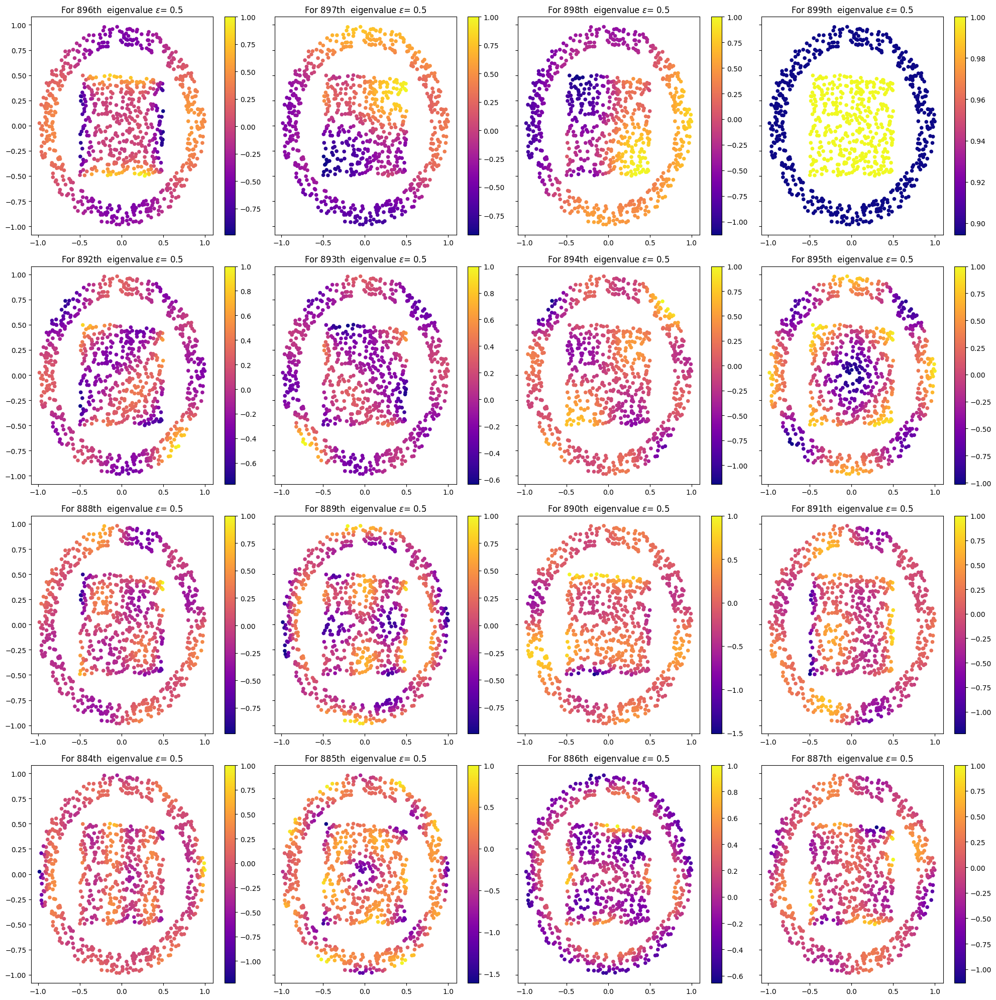

In [82]:
eigenmodes_count = 16

X=np.hstack((np.hstack((x[0,:],y[0,:]))[:,None],np.hstack((x[1,:],y[1,:]))[:,None]))
fig, ax = plt.subplots(figsize=(20,20),nrows=eigenmodes_count//4, ncols=eigenmodes_count//4,sharey=True)
scale = 30

courant_modes = []
k=0
for i in range(eigenmodes_count//4):
    eigenvectors = eigvecs[1]
    courant_modes.append( [] )
    for j in range(eigenmodes_count//4):
        function_as_vector = eigenvectors[:,N[0]+N[1]-j-1-4*k]
        function_as_vector = function_as_vector/np.max(function_as_vector)
        # Flip sign if anti-correlated
        if i>0:
            old_mode = courant_modes[i-1][j]
            correlation = np.dot( old_mode, function_as_vector)/(np.linalg.norm(old_mode)*np.linalg.norm(function_as_vector))
            if correlation<-0.1:
                function_as_vector = -function_as_vector
            #print( "epsilon: ", i, " -- corr = ",
            #  correlation )
        # Record
        courant_modes[i].append( function_as_vector )
        # Plot
        im = ax[i][eigenmodes_count//4-j-1].scatter(X.T[0,:], X.T[1,:], s=scale, edgecolors=(0,0,0,0),  c=function_as_vector, cmap='plasma', linewidths=2)
        fig.colorbar(im,ax=ax[i][eigenmodes_count//4-j-1])
    # end for
    ax[i][3].set_title("For "+str(N[0]+N[1]-1-4*k)+"th  eigenvalue $\epsilon$= "+str(epsilons[1]))
    ax[i][2].set_title("For "+str(N[0]+N[1]-2-4*k)+"th  eigenvalue $\epsilon$= "+str(epsilons[1]))
    ax[i][1].set_title("For "+str(N[0]+N[1]-3-4*k)+"th  eigenvalue $\epsilon$= "+str(epsilons[1]))
    ax[i][0].set_title("For "+str(N[0]+N[1]-4-4*k)+"th  eigenvalue $\epsilon$= "+str(epsilons[1]))
    #ax[i][0].set_title("For $5^{th}$ largest eigenvalue $\epsilon$= "+str(epsilons[i]))
    k+=1
# plt.axis("off")
plt.xlim(np.min(X.T[0,:])-.1,np.max(X.T[0,:])+.1)   
plt.ylim(np.min(X.T[1,:])-.1,np.max(X.T[1,:])+.1)
plt.subplots_adjust(wspace=0,hspace=0.09)
plt.tight_layout()
plt.savefig("DampedNewtonTesting_images/EigenheatmaplargestL4.png")
plt.show();



# L-infinity

In [83]:
rho = 0.95
c = 0.05
DampedNewtonP = []
results_DampedNewton  = []
times_DampedNewton    = []
Hessians_DampedNewton = []

#epsilons=[0.05,0.08,0.1]
#epsilons=[0.1, 0.2, 0.3, 0.4, 0.5, 0.75, 1.0 ]
epsilons = [ 1.0, 0.5, 0.1, 0.05,0.03 ]
for eps in epsilons:
    # Line Search
    print("Damped Newton for epsilon="+str(eps)+":")    
    #Cost matrix
    C = p_norms(x,y,'inf')

    # a and b
    a = normalize(np.ones(N[0]))
    a = a.reshape(a.shape[0],-1)
    b = normalize(np.ones(N[1]))
    b = b.reshape(b.shape[0],-1)

    #Epsilon 

    # epsilon = .05

    #Kernel
    K = np.exp(-C/eps)

    f,g = 0*a,0*b

    print("Doing for (",N[0],N[1],").")
    print( " |- Iterating")  
    start = time.time()
    Optimizer = computational_OT.DampedNewton(K,a,b,f,g,eps,rho,c)
    out=Optimizer._update(maxiter=50, debug=True)
    results_DampedNewton.append(out)
    end=time.time()
    times_DampedNewton.append(end-start)
    print( " |- Computing P")
    
    DampedNewtonP.append(GetP(np.exp(out['potential_f']/eps),K,np.exp(out['potential_g']/eps)))
    print( " |- Recording (unstabilized) Hessian \n")

    mat  = -eps*Optimizer.Hessian
    diag = 1/np.sqrt( np.vstack( (a,b) ) ).flatten()
    mat = diag*mat*diag
    Hessians_DampedNewton.append( mat )


Damped Newton for epsilon=1.0:
Doing for ( 400 500 ).
 |- Iterating
Terminating after iteration:  17
 |- Computing P
 |- Recording (unstabilized) Hessian 

Damped Newton for epsilon=0.5:
Doing for ( 400 500 ).
 |- Iterating
Terminating after iteration:  16
 |- Computing P
 |- Recording (unstabilized) Hessian 

Damped Newton for epsilon=0.1:
Doing for ( 400 500 ).
 |- Iterating
Terminating after iteration:  16
 |- Computing P
 |- Recording (unstabilized) Hessian 

Damped Newton for epsilon=0.05:
Doing for ( 400 500 ).
 |- Iterating
Terminating after iteration:  15
 |- Computing P
 |- Recording (unstabilized) Hessian 

Damped Newton for epsilon=0.03:
Doing for ( 400 500 ).
 |- Iterating
Terminating after iteration:  17
 |- Computing P
 |- Recording (unstabilized) Hessian 



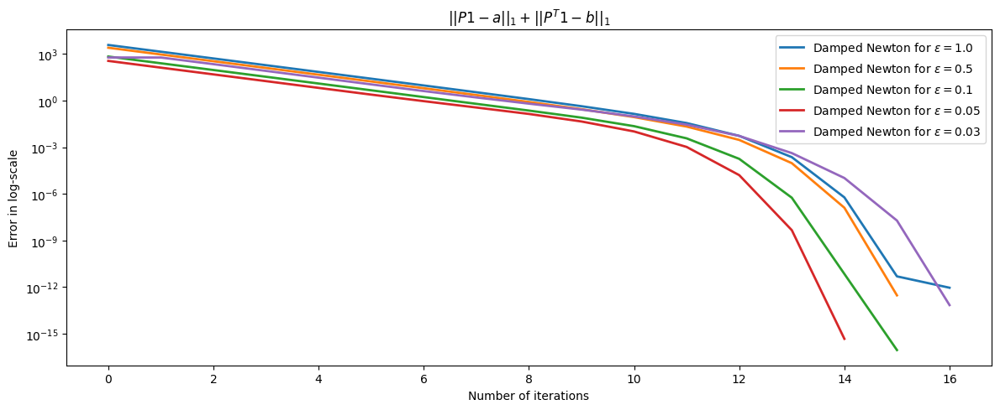


 Error plots can increase! The error is not the objective function!


In [84]:
plt.figure(figsize = (12,5))
plt.title("$$")
plt.title("$||P1 -a||_1+||P^T 1 -b||_1$")

for i in range(len(results_DampedNewton)):
  error=np.asarray(results_DampedNewton[i]['error_a'])+np.asarray(results_DampedNewton[i]['error_b'])
  plt.plot( error,label='Damped Newton for $\epsilon=$'+ str(epsilons[i]), linewidth = 2)

plt.xlabel("Number of iterations")
plt.ylabel("Error in log-scale")
plt.legend()
plt.yscale( 'log')
plt.tight_layout()
plt.savefig("DampedNewtonTesting_images/ErrorLinesearchNewtonLinfinity.png")
plt.show()

print("\n Error plots can increase! The error is not the objective function!")

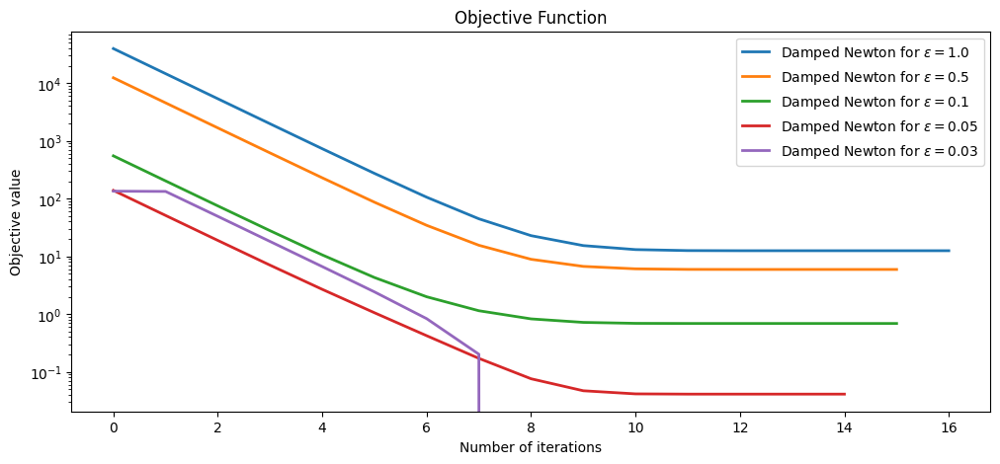

In [85]:
plt.figure(figsize = (12,5))
plt.title("$$")

plt.title("Objective Function")

for i in range(len(results_DampedNewton)):
  value = np.asarray(results_DampedNewton[i]['objectives'])
  value = -(value)
  plt.plot( value,label='Damped Newton for $\epsilon=$'+ str(epsilons[i]), linewidth = 2)

plt.xlabel("Number of iterations")
plt.ylabel("Objective value")
plt.yscale('log')
plt.legend()
plt.savefig("DampedNewtonTesting_images/ObjectiveLineSearchNewtonLinfinity.png")
plt.show()


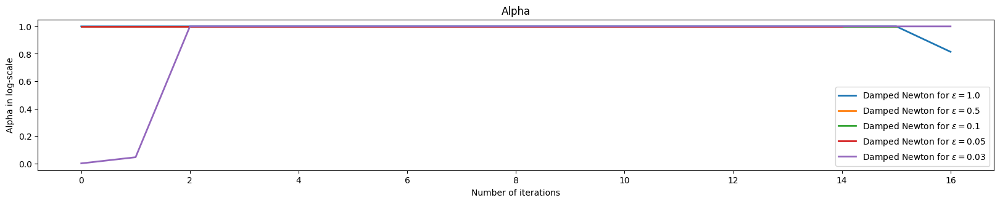

In [86]:
plt.figure(figsize = (20,7))
plt.subplot(2,1,1),
plt.title("Alpha")

for i in range(len(results_DampedNewton)):
  plt.plot( np.asarray(results_DampedNewton[i]["linesearch_steps"]),label='Damped Newton for $\epsilon=$'+ str(epsilons[i]), linewidth = 2)

plt.xlabel("Number of iterations")
plt.ylabel("Alpha in log-scale")
plt.legend()
# plt.yscale( 'log')
plt.savefig("DampedNewtonTesting_images/AlphaLineSearchNewtonLinfinity.png")
plt.show()



In [87]:
eigs=[]
eigvecs=[]
for i in range(len(epsilons)):
    eps = epsilons[i]
    print("Spectral statistics of Hessian for epsilon="+str(eps))
    Hessian = Hessians_DampedNewton[i]
    ev=print_spectral_statistics( Hessian, stabilize=False)
    eigs.append(ev[0])
    eigvecs.append(ev[1])
    print("")


Spectral statistics of Hessian for epsilon=1.0
List of smallest eigenvalues:  [0.10557281 0.86495122 0.9626596  0.98442468 0.99081513 0.9946553
 0.99647173 0.99726927 0.99789324 0.99840991]
List of largest  eigenvalues:  [1.00159009 1.00210676 1.00273073 1.00352827 1.0053447  1.00918487
 1.01557532 1.0373404  1.13504878 1.89442719]
Condition number:  17.94427190999916

Spectral statistics of Hessian for epsilon=0.5
List of smallest eigenvalues:  [0.1055729  0.76546255 0.92385711 0.9663799  0.97945295 0.98796977
 0.99206834 0.99374085 0.99507318 0.99632603]
List of largest  eigenvalues:  [1.00367712 1.00493034 1.00626193 1.00793479 1.01203387 1.02055038
 1.03362333 1.07614624 1.23453975 1.89442883]
Condition number:  17.944271910057946

Spectral statistics of Hessian for epsilon=0.1
List of smallest eigenvalues:  [0.10557281 0.47258335 0.7582698  0.86409741 0.91636493 0.93691655
 0.95007185 0.96406188 0.97139782 0.97665282]
List of largest  eigenvalues:  [1.02334718 1.02860218 1.0359381

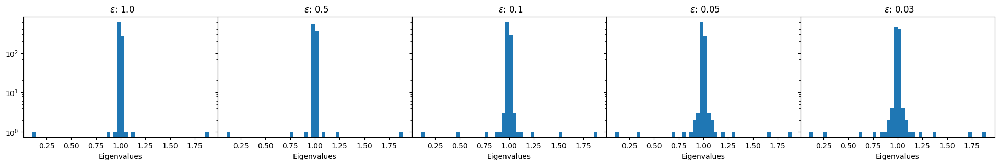

In [88]:
fig,ax = plt.subplots( figsize=(24,3),nrows=1, ncols=len(epsilons), sharey=True )
plt.title( "Histogram of eigenvalues." )
for i in range( len(epsilons) ):
    if not np.isnan(eigs[i]).any():
        ax[i].hist( eigs[i], 50 )
        ax[i].set_title( " $\epsilon$: "+str(epsilons[i]) )
        ax[i].set_xlabel( "Eigenvalues" )
        ax[i].set_yscale( "log" )
    
    else:
        print("The eigenvalues for "+str(epsilons[i])+ " contains Nans.")
plt.subplots_adjust( wspace=0,hspace=0 )
plt.savefig("DampedNewtonVsSinkhorn_benchmark_annulusVSsquare_images/eigenhistunstabilizedLinfinity.png")
plt.show()

### Heatmaps of eigenvectors corresponding to the 16 smallest eigenvalues 

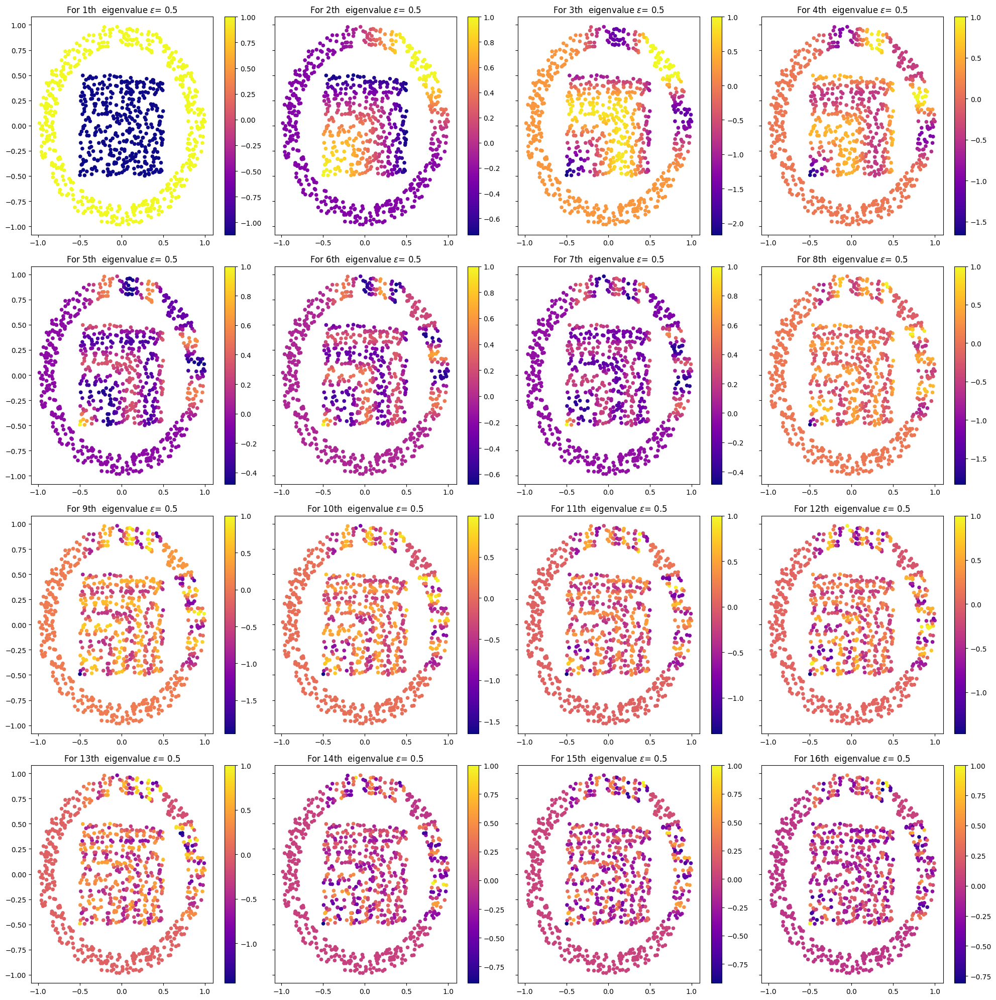

In [89]:
eigenmodes_count = 16

X=np.hstack((np.hstack((x[0,:],y[0,:]))[:,None],np.hstack((x[1,:],y[1,:]))[:,None]))
fig, ax = plt.subplots(figsize=(20,20),nrows=eigenmodes_count//4, ncols=eigenmodes_count//4,sharey=True)
scale = 30

courant_modes = []
k=0
for i in range(eigenmodes_count//4):
    eigenvectors = eigvecs[1]
    courant_modes.append( [] )
    for j in range(eigenmodes_count//4):
        function_as_vector = eigenvectors[:,j+4*k]
        function_as_vector = function_as_vector/np.max(function_as_vector)
        # Flip sign if anti-correlated
        if i>0:
            old_mode = courant_modes[i-1][j]
            correlation = np.dot( old_mode, function_as_vector)/(np.linalg.norm(old_mode)*np.linalg.norm(function_as_vector))
            if correlation<-0.1:
                function_as_vector = -function_as_vector
        # Record
        courant_modes[i].append( function_as_vector )
        # Plot
        im1 = ax[i][j].scatter(X.T[0,:], X.T[1,:], s=scale, edgecolors=(0,0,0,0),  c=function_as_vector, cmap='plasma', linewidths=2)
        fig.colorbar(im1,ax=ax[i][j])
    # end for
    ax[i][0].set_title("For "+str(1+4*k)+"th  eigenvalue $\epsilon$= "+str(epsilons[1]))
    ax[i][1].set_title("For "+str(2+4*k)+"th  eigenvalue $\epsilon$= "+str(epsilons[1]))
    ax[i][2].set_title("For "+str(3+4*k)+"th  eigenvalue $\epsilon$= "+str(epsilons[1]))
    ax[i][3].set_title("For "+str(4+4*k)+"th  eigenvalue $\epsilon$= "+str(epsilons[1]))
    #ax[i][4].set_title("For $5^{th}$ smallest eigenvalue $\epsilon$= "+str(epsilons[i]))
    k+=1
# end for

#fig.colorbar(im1, ax=ax.ravel().tolist())
plt.xlim(np.min(X.T[0,:])-.1,np.max(X.T[0,:])+.1)
plt.ylim(np.min(X.T[1,:])-.1,np.max(X.T[1,:])+.1)
plt.subplots_adjust(wspace=0,hspace=0.09)
plt.tight_layout()
plt.savefig("DampedNewtonTesting_images/EigenheatmaplowestLinfinity.png")
plt.show();



### Heatmaps of eigenvectors corresponding to the 16 largest eigenvalues

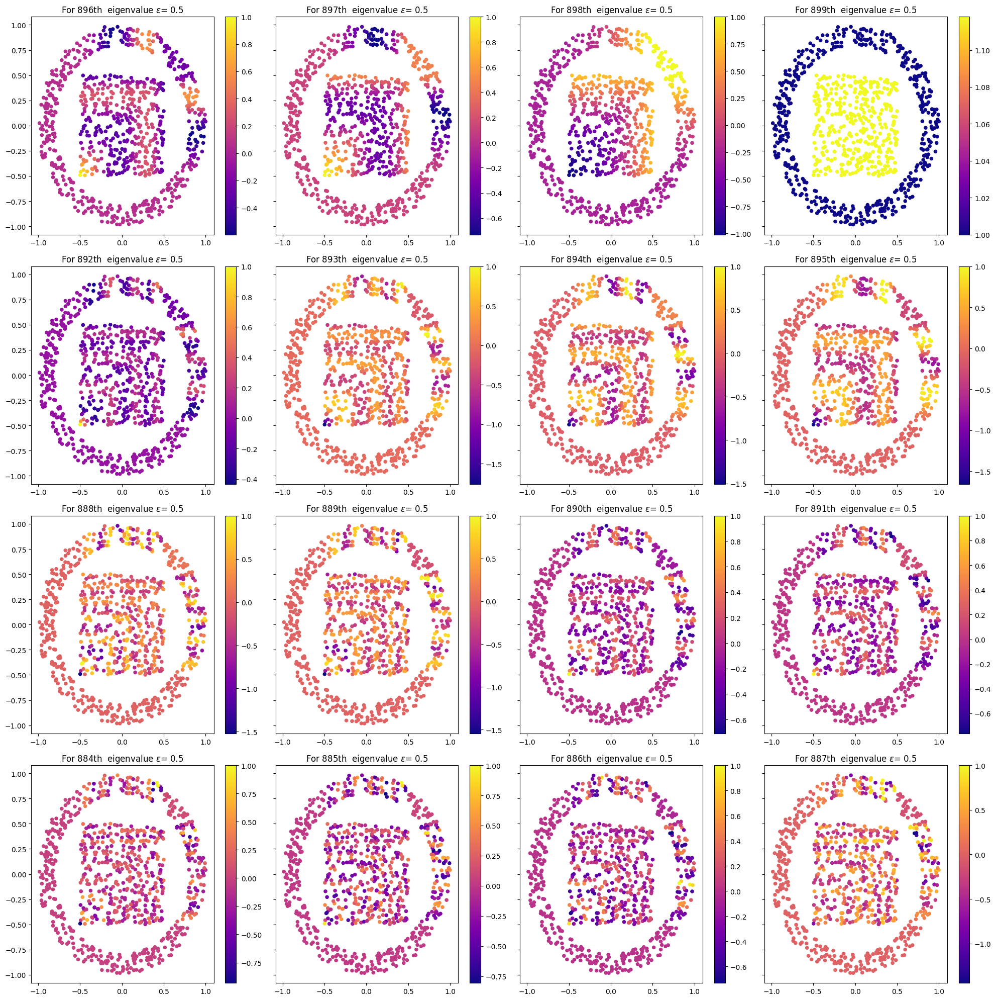

In [90]:
eigenmodes_count = 16

X=np.hstack((np.hstack((x[0,:],y[0,:]))[:,None],np.hstack((x[1,:],y[1,:]))[:,None]))
fig, ax = plt.subplots(figsize=(20,20),nrows=eigenmodes_count//4, ncols=eigenmodes_count//4,sharey=True)
scale = 30

courant_modes = []
k=0
for i in range(eigenmodes_count//4):
    eigenvectors = eigvecs[1]
    courant_modes.append( [] )
    for j in range(eigenmodes_count//4):
        function_as_vector = eigenvectors[:,N[0]+N[1]-j-1-4*k]
        function_as_vector = function_as_vector/np.max(function_as_vector)
        # Flip sign if anti-correlated
        if i>0:
            old_mode = courant_modes[i-1][j]
            correlation = np.dot( old_mode, function_as_vector)/(np.linalg.norm(old_mode)*np.linalg.norm(function_as_vector))
            if correlation<-0.1:
                function_as_vector = -function_as_vector
            #print( "epsilon: ", i, " -- corr = ",
            #  correlation )
        # Record
        courant_modes[i].append( function_as_vector )
        # Plot
        im = ax[i][eigenmodes_count//4-j-1].scatter(X.T[0,:], X.T[1,:], s=scale, edgecolors=(0,0,0,0),  c=function_as_vector, cmap='plasma', linewidths=2)
        fig.colorbar(im,ax=ax[i][eigenmodes_count//4-j-1])
    # end for
    ax[i][3].set_title("For "+str(N[0]+N[1]-1-4*k)+"th  eigenvalue $\epsilon$= "+str(epsilons[1]))
    ax[i][2].set_title("For "+str(N[0]+N[1]-2-4*k)+"th  eigenvalue $\epsilon$= "+str(epsilons[1]))
    ax[i][1].set_title("For "+str(N[0]+N[1]-3-4*k)+"th  eigenvalue $\epsilon$= "+str(epsilons[1]))
    ax[i][0].set_title("For "+str(N[0]+N[1]-4-4*k)+"th  eigenvalue $\epsilon$= "+str(epsilons[1]))
    #ax[i][0].set_title("For $5^{th}$ largest eigenvalue $\epsilon$= "+str(epsilons[i]))
    k+=1
# plt.axis("off")
plt.xlim(np.min(X.T[0,:])-.1,np.max(X.T[0,:])+.1)   
plt.ylim(np.min(X.T[1,:])-.1,np.max(X.T[1,:])+.1)
plt.subplots_adjust(wspace=0,hspace=0.09)
plt.tight_layout()
plt.savefig("DampedNewtonTesting_images/EigenheatmaplargestLinfinity.png")
plt.show();



# 1-cosine similarity

In [91]:
rho = 0.95
c = 0.05
DampedNewtonP = []
results_DampedNewton  = []
times_DampedNewton    = []
Hessians_DampedNewton = []

#epsilons=[0.05,0.08,0.1]
#epsilons=[0.1, 0.2, 0.3, 0.4, 0.5, 0.75, 1.0 ]
epsilons = [ 1.0, 0.5, 0.1, 0.05,0.03 ]
for eps in epsilons:
    # Line Search
    print("Damped Newton for epsilon="+str(eps)+":")    
    #Cost matrix
    C =1- (x.transpose().dot(y))/(np.linalg.norm(x,2)*np.linalg.norm(y,2))

    # a and b
    a = normalize(np.ones(N[0]))
    a = a.reshape(a.shape[0],-1)
    b = normalize(np.ones(N[1]))
    b = b.reshape(b.shape[0],-1)

    #Epsilon 

    # epsilon = .05

    #Kernel
    K = np.exp(-C/eps)

    f,g = 0*a,0*b

    print("Doing for (",N[0],N[1],").")
    print( " |- Iterating")  
    start = time.time()
    Optimizer = computational_OT.DampedNewton(K,a,b,f,g,eps,rho,c)
    out=Optimizer._update(maxiter=50, debug=True)
    results_DampedNewton.append(out)
    end=time.time()
    times_DampedNewton.append(end-start)
    print( " |- Computing P")
    
    DampedNewtonP.append(GetP(np.exp(out['potential_f']/eps),K,np.exp(out['potential_g']/eps)))
    print( " |- Recording (unstabilized) Hessian \n")

    mat  = -eps*Optimizer.Hessian
    diag = 1/np.sqrt( np.vstack( (a,b) ) ).flatten()
    mat = diag*mat*diag
    Hessians_DampedNewton.append( mat )


Damped Newton for epsilon=1.0:
Doing for ( 400 500 ).
 |- Iterating
Terminating after iteration:  16
 |- Computing P
 |- Recording (unstabilized) Hessian 

Damped Newton for epsilon=0.5:
Doing for ( 400 500 ).
 |- Iterating
Terminating after iteration:  16
 |- Computing P
 |- Recording (unstabilized) Hessian 

Damped Newton for epsilon=0.1:
Doing for ( 400 500 ).
 |- Iterating
Terminating after iteration:  8
 |- Computing P
 |- Recording (unstabilized) Hessian 

Damped Newton for epsilon=0.05:
Doing for ( 400 500 ).
 |- Iterating
Terminating after iteration:  8
 |- Computing P
 |- Recording (unstabilized) Hessian 

Damped Newton for epsilon=0.03:
Doing for ( 400 500 ).
 |- Iterating
Terminating after iteration:  8
 |- Computing P
 |- Recording (unstabilized) Hessian 



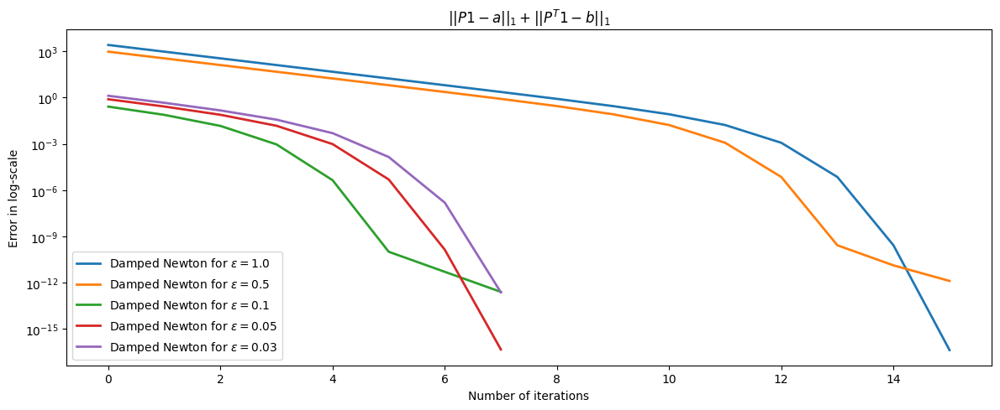


 Error plots can increase! The error is not the objective function!


In [92]:
plt.figure(figsize = (12,5))
plt.title("$$")
plt.title("$||P1 -a||_1+||P^T 1 -b||_1$")

for i in range(len(results_DampedNewton)):
  error=np.asarray(results_DampedNewton[i]['error_a'])+np.asarray(results_DampedNewton[i]['error_b'])
  plt.plot( error,label='Damped Newton for $\epsilon=$'+ str(epsilons[i]), linewidth = 2)

plt.xlabel("Number of iterations")
plt.ylabel("Error in log-scale")
plt.legend()
plt.yscale( 'log')
plt.tight_layout()
plt.savefig("DampedNewtonTesting_images/ErrorLinesearchNewtoncosine.png")
plt.show()

print("\n Error plots can increase! The error is not the objective function!")

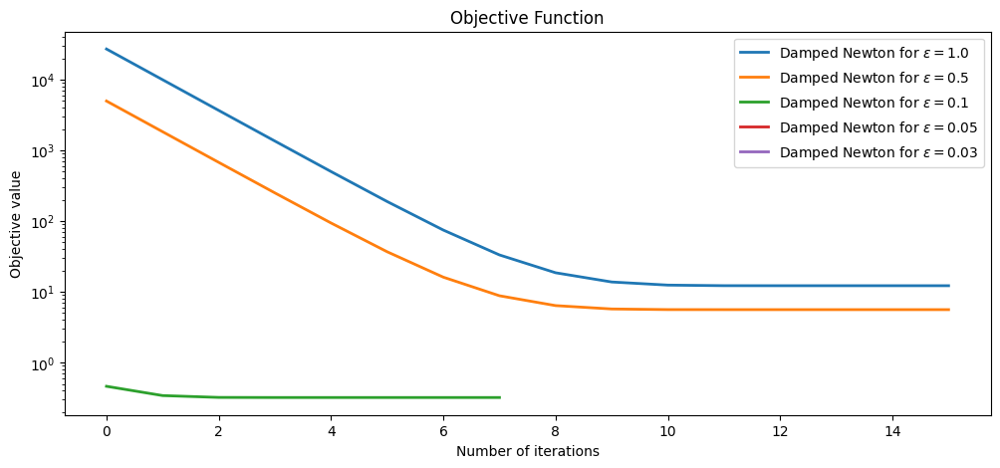

In [93]:
plt.figure(figsize = (12,5))
plt.title("$$")

plt.title("Objective Function")

for i in range(len(results_DampedNewton)):
  value = np.asarray(results_DampedNewton[i]['objectives'])
  value = -(value)
  plt.plot( value,label='Damped Newton for $\epsilon=$'+ str(epsilons[i]), linewidth = 2)

plt.xlabel("Number of iterations")
plt.ylabel("Objective value")
plt.yscale('log')
plt.legend()
plt.savefig("DampedNewtonTesting_images/ObjectiveLineSearchNewtoncosine.png")
plt.show()


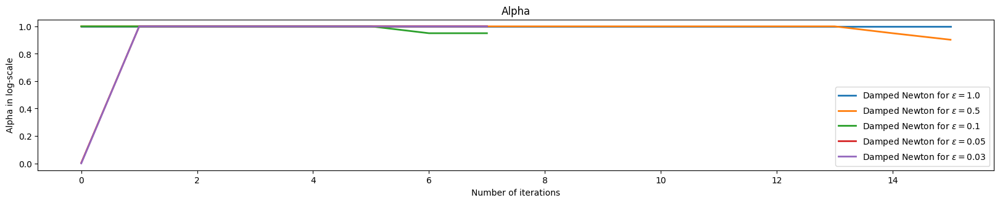

In [94]:
plt.figure(figsize = (20,7))
plt.subplot(2,1,1),
plt.title("Alpha")

for i in range(len(results_DampedNewton)):
  plt.plot( np.asarray(results_DampedNewton[i]["linesearch_steps"]),label='Damped Newton for $\epsilon=$'+ str(epsilons[i]), linewidth = 2)

plt.xlabel("Number of iterations")
plt.ylabel("Alpha in log-scale")
plt.legend()
# plt.yscale( 'log')
plt.savefig("DampedNewtonTesting_images/AlphaLineSearchNewtoncosine.png")
plt.show()



In [95]:
eigs=[]
eigvecs=[]
for i in range(len(epsilons)):
    eps = epsilons[i]
    print("Spectral statistics of Hessian for epsilon="+str(eps))
    Hessian = Hessians_DampedNewton[i]
    ev=print_spectral_statistics( Hessian, stabilize=False)
    eigs.append(ev[0])
    eigvecs.append(ev[1])
    print("")


Spectral statistics of Hessian for epsilon=1.0
List of smallest eigenvalues:  [0.10557281 0.998038   0.99815958 0.99999717 0.9999982  0.99999968
 1.         1.         1.         1.        ]
List of largest  eigenvalues:  [1.         1.         1.         1.         1.00000033 1.0000018
 1.00000283 1.00184043 1.00196201 1.8944272 ]
Condition number:  17.944271909999035

Spectral statistics of Hessian for epsilon=0.5
List of smallest eigenvalues:  [0.10557281 0.99607602 0.9963192  0.99998868 0.9999928  0.9999987
 0.99999998 0.99999998 1.         1.        ]
List of largest  eigenvalues:  [1.         1.         1.00000002 1.00000002 1.0000013  1.0000072
 1.00001132 1.0036808  1.00392398 1.89442719]
Condition number:  17.94427190999908

Spectral statistics of Hessian for epsilon=0.1
List of smallest eigenvalues:  [0.10557281 0.98038605 0.98160197 0.99971705 0.99982007 0.99996759
 0.99999794 0.99999808 0.99999974 0.99999974]
List of largest  eigenvalues:  [1.00000026 1.00000026 1.00000192 

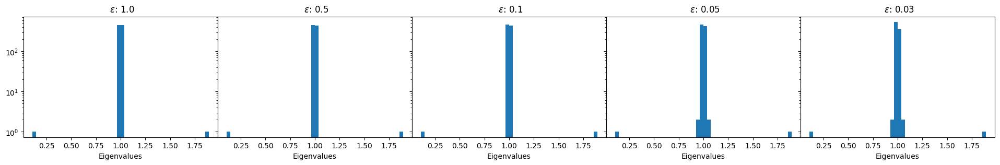

In [96]:
fig,ax = plt.subplots( figsize=(24,3),nrows=1, ncols=len(epsilons), sharey=True )
plt.title( "Histogram of eigenvalues." )
for i in range( len(epsilons) ):
    if not np.isnan(eigs[i]).any():
        ax[i].hist( eigs[i], 50 )
        ax[i].set_title( " $\epsilon$: "+str(epsilons[i]) )
        ax[i].set_xlabel( "Eigenvalues" )
        ax[i].set_yscale( "log" )
    
    else:
        print("The eigenvalues for "+str(epsilons[i])+ " contains Nans.")
plt.subplots_adjust( wspace=0,hspace=0 )
plt.savefig("DampedNewtonVsSinkhorn_benchmark_annulusVSsquare_images/eigenhistunstabilizedcosine.png")
plt.show()

### Heatmaps of eigenvectors corresponding to the 16 smallest eigenvalues 

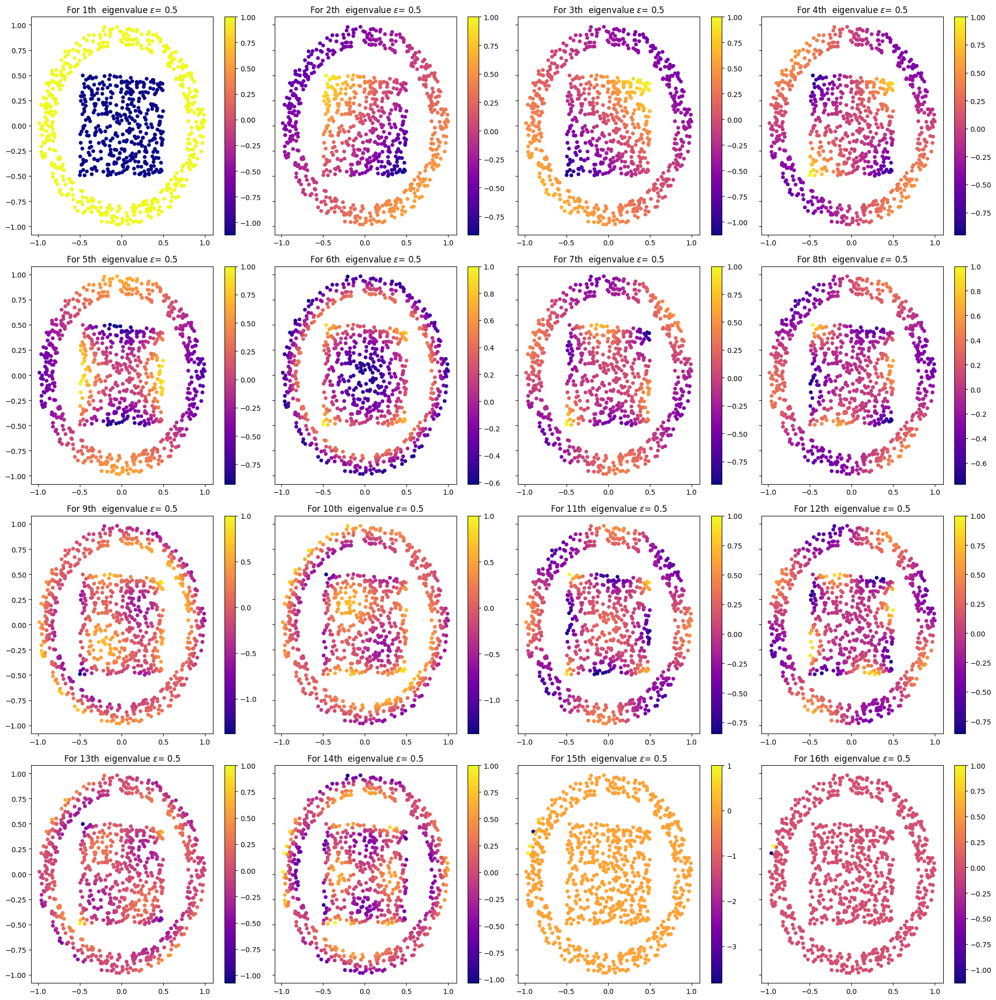

In [97]:
eigenmodes_count = 16

X=np.hstack((np.hstack((x[0,:],y[0,:]))[:,None],np.hstack((x[1,:],y[1,:]))[:,None]))
fig, ax = plt.subplots(figsize=(20,20),nrows=eigenmodes_count//4, ncols=eigenmodes_count//4,sharey=True)
scale = 30

courant_modes = []
k=0
for i in range(eigenmodes_count//4):
    eigenvectors = eigvecs[1]
    courant_modes.append( [] )
    for j in range(eigenmodes_count//4):
        function_as_vector = eigenvectors[:,j+4*k]
        function_as_vector = function_as_vector/np.max(function_as_vector)
        # Flip sign if anti-correlated
        if i>0:
            old_mode = courant_modes[i-1][j]
            correlation = np.dot( old_mode, function_as_vector)/(np.linalg.norm(old_mode)*np.linalg.norm(function_as_vector))
            if correlation<-0.1:
                function_as_vector = -function_as_vector
        # Record
        courant_modes[i].append( function_as_vector )
        # Plot
        im1 = ax[i][j].scatter(X.T[0,:], X.T[1,:], s=scale, edgecolors=(0,0,0,0),  c=function_as_vector, cmap='plasma', linewidths=2)
        fig.colorbar(im1,ax=ax[i][j])
    # end for
    ax[i][0].set_title("For "+str(1+4*k)+"th  eigenvalue $\epsilon$= "+str(epsilons[1]))
    ax[i][1].set_title("For "+str(2+4*k)+"th  eigenvalue $\epsilon$= "+str(epsilons[1]))
    ax[i][2].set_title("For "+str(3+4*k)+"th  eigenvalue $\epsilon$= "+str(epsilons[1]))
    ax[i][3].set_title("For "+str(4+4*k)+"th  eigenvalue $\epsilon$= "+str(epsilons[1]))
    #ax[i][4].set_title("For $5^{th}$ smallest eigenvalue $\epsilon$= "+str(epsilons[i]))
    k+=1
# end for

#fig.colorbar(im1, ax=ax.ravel().tolist())
plt.xlim(np.min(X.T[0,:])-.1,np.max(X.T[0,:])+.1)
plt.ylim(np.min(X.T[1,:])-.1,np.max(X.T[1,:])+.1)
plt.subplots_adjust(wspace=0,hspace=0.09)
plt.tight_layout()
plt.savefig("DampedNewtonTesting_images/Eigenheatmaplowestcosine.png")
plt.show();



### Heatmaps of eigenvectors corresponding to the 16 largest eigenvalues

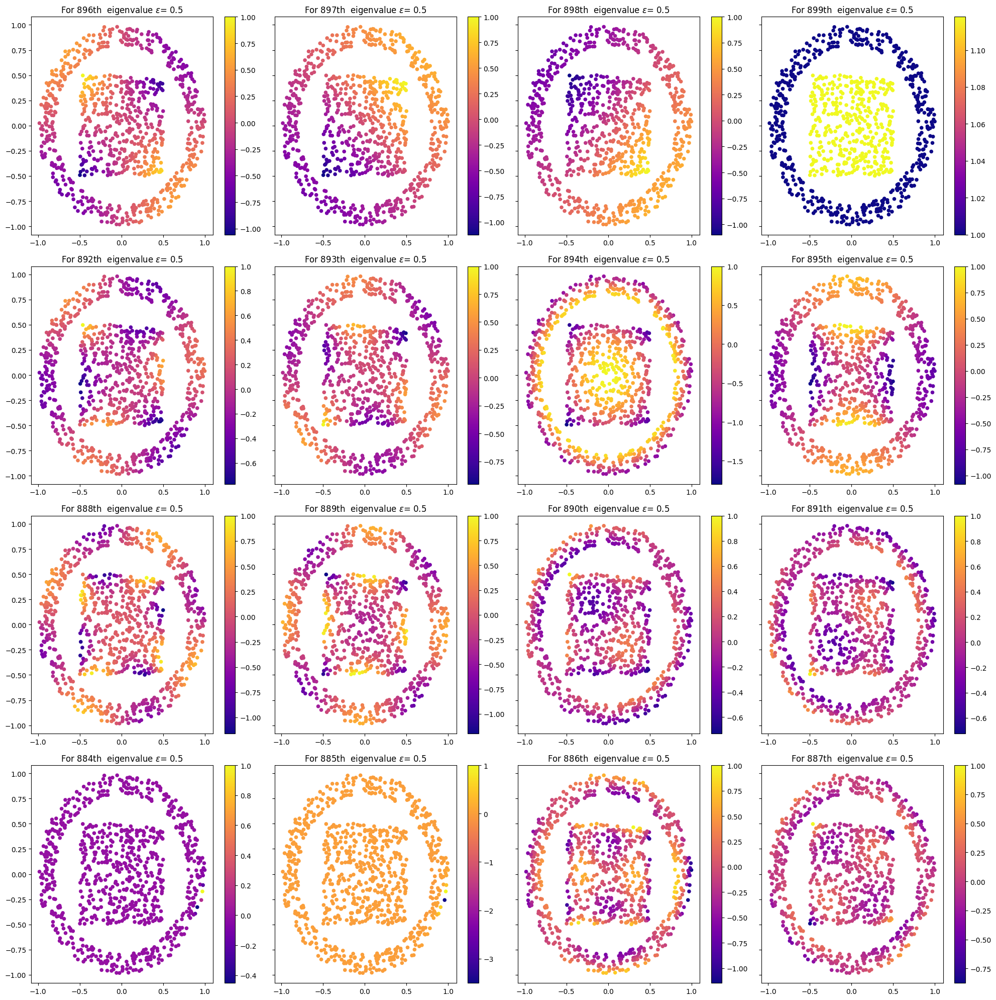

In [98]:
eigenmodes_count = 16

X=np.hstack((np.hstack((x[0,:],y[0,:]))[:,None],np.hstack((x[1,:],y[1,:]))[:,None]))
fig, ax = plt.subplots(figsize=(20,20),nrows=eigenmodes_count//4, ncols=eigenmodes_count//4,sharey=True)
scale = 30

courant_modes = []
k=0
for i in range(eigenmodes_count//4):
    eigenvectors = eigvecs[1]
    courant_modes.append( [] )
    for j in range(eigenmodes_count//4):
        function_as_vector = eigenvectors[:,N[0]+N[1]-j-1-4*k]
        function_as_vector = function_as_vector/np.max(function_as_vector)
        # Flip sign if anti-correlated
        if i>0:
            old_mode = courant_modes[i-1][j]
            correlation = np.dot( old_mode, function_as_vector)/(np.linalg.norm(old_mode)*np.linalg.norm(function_as_vector))
            if correlation<-0.1:
                function_as_vector = -function_as_vector
            #print( "epsilon: ", i, " -- corr = ",
            #  correlation )
        # Record
        courant_modes[i].append( function_as_vector )
        # Plot
        im = ax[i][eigenmodes_count//4-j-1].scatter(X.T[0,:], X.T[1,:], s=scale, edgecolors=(0,0,0,0),  c=function_as_vector, cmap='plasma', linewidths=2)
        fig.colorbar(im,ax=ax[i][eigenmodes_count//4-j-1])
    # end for
    ax[i][3].set_title("For "+str(N[0]+N[1]-1-4*k)+"th  eigenvalue $\epsilon$= "+str(epsilons[1]))
    ax[i][2].set_title("For "+str(N[0]+N[1]-2-4*k)+"th  eigenvalue $\epsilon$= "+str(epsilons[1]))
    ax[i][1].set_title("For "+str(N[0]+N[1]-3-4*k)+"th  eigenvalue $\epsilon$= "+str(epsilons[1]))
    ax[i][0].set_title("For "+str(N[0]+N[1]-4-4*k)+"th  eigenvalue $\epsilon$= "+str(epsilons[1]))
    #ax[i][0].set_title("For $5^{th}$ largest eigenvalue $\epsilon$= "+str(epsilons[i]))
    k+=1
# plt.axis("off")
plt.xlim(np.min(X.T[0,:])-.1,np.max(X.T[0,:])+.1)   
plt.ylim(np.min(X.T[1,:])-.1,np.max(X.T[1,:])+.1)
plt.subplots_adjust(wspace=0,hspace=0.09)
plt.tight_layout()
plt.savefig("DampedNewtonTesting_images/Eigenheatmaplargestcosine.png")
plt.show();

